<a href="https://colab.research.google.com/github/ajiyamoiz/CS-876-Computer-Vision-Course/blob/main/traffic_sign_detection_yolov3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [44]:
#mounting drive
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# Download Data

In [45]:
#download zip file containing images and ground truth values.
!wget --header 'Host: sid.erda.dk' --user-agent 'Mozilla/5.0 (Windows NT 10.0; Win64; x64; rv:79.0) Gecko/20100101 Firefox/79.0' --header 'Accept: text/html,application/xhtml+xml,application/xml;q=0.9,image/webp,*/*;q=0.8' --header 'Accept-Language: en-US,en;q=0.5' --referer 'https://sid.erda.dk/public/archives/ff17dc924eba88d5d01a807357d6614c/published-archive.html' --header 'Upgrade-Insecure-Requests: 1' 'https://sid.erda.dk/public/archives/ff17dc924eba88d5d01a807357d6614c/TrainIJCNN2013.zip' --output-document 'TrainIJCNN2013.zip'

--2022-12-29 19:33:02--  https://sid.erda.dk/public/archives/ff17dc924eba88d5d01a807357d6614c/TrainIJCNN2013.zip
Resolving sid.erda.dk (sid.erda.dk)... 130.225.104.13
Connecting to sid.erda.dk (sid.erda.dk)|130.225.104.13|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1104177081 (1.0G) [application/zip]
Saving to: ‘TrainIJCNN2013.zip’

TrainIJCNN2013.zip  100%[===================>]   1.03G  24.6MB/s    in 49s     

2022-12-29 19:33:51 (21.6 MB/s) - ‘TrainIJCNN2013.zip’ saved [1104177081/1104177081]



In [46]:
#unziping the downloaded zip file
!unzip '/content/TrainIJCNN2013.zip'

Archive:  /content/TrainIJCNN2013.zip
replace TrainIJCNN2013/00000.ppm? [y]es, [n]o, [A]ll, [N]one, [r]ename: 
error:  invalid response [{ENTER}]
replace TrainIJCNN2013/00000.ppm? [y]es, [n]o, [A]ll, [N]one, [r]ename: N


# Preprocessing

In [47]:
#importing necessary libraries.
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
%matplotlib inline

**Class id labels**:

0 = speed limit 20 (prohibitory)

1 = speed limit 30 (prohibitory)

2 = speed limit 50 (prohibitory)

3 = speed limit 60 (prohibitory)

4 = speed limit 70 (prohibitory)

5 = speed limit 80 (prohibitory)

6 = restriction ends 80 (other)

7 = speed limit 100 (prohibitory)

8 = speed limit 120 (prohibitory)

9 = no overtaking (prohibitory)

10 = no overtaking (trucks) (prohibitory)

11 = priority at next intersection (danger)

12 = priority road (other)

13 = give way (other)

14 = stop (other)

15 = no traffic both ways (prohibitory)

16 = no trucks (prohibitory)

17 = no entry (other)

18 = danger (danger)

19 = bend left (danger)

20 = bend right (danger)

21 = bend (danger)

22 = uneven road (danger)

23 = slippery road (danger)

24 = road narrows (danger)

25 = construction (danger)

26 = traffic signal (danger)

27 = pedestrian crossing (danger)

28 = school crossing (danger)

29 = cycles crossing (danger)

30 = snow (danger)

31 = animals (danger)

32 = restriction ends (other)

33 = go right (mandatory)

34 = go left (mandatory)

35 = go straight (mandatory)

36 = go right or straight (mandatory)

37 = go left or straight (mandatory)

38 = keep right (mandatory)

39 = keep left (mandatory)

40 = roundabout (mandatory)

41 = restriction ends (overtaking) (other)

42 = restriction ends (overtaking (trucks)) (other)

# Data preprocessing:

In [48]:
#reading data
data = pd.read_csv('/content/TrainIJCNN2013/gt.txt',sep=';',names=['path','left','top','right','bottom','id'])

In [49]:
data.head()

,path,left,top,right,bottom,id
0,00000.ppm,774,411,815,446,11
1,00001.ppm,983,388,1024,432,40
2,00001.ppm,386,494,442,552,38
3,00001.ppm,973,335,1031,390,13
4,00002.ppm,892,476,1006,592,39


# Exploratory data analysis

## Image

In [50]:
Path = ('/content/TrainIJCNN2013/')

In [51]:
from PIL import Image
#opening image and converting it into numpy array and checking the size of array.
img = Image.open(Path + data['path'][0])
#img = Image.open('/content/TrainIJCNN2013/00000.ppm')
img.show()
img=np.array(img)
print(img.shape)

(800, 1360, 3)


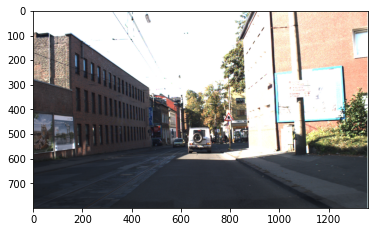

In [52]:
#n
img=np.array(img)
plt.imshow(img[:,:,:])

In [53]:
#checking size of all arrays
size=[]
for i in range(len(data)):
  img = Image.open(Path + data['path'][i])
  img=np.array(img)
  size.append(img.shape)

All images are of size 800*1360 with 3 channels

In [54]:
#converting all images to array representation to use it afterwards.
image_array=[]
for i in range(len(data)):
  img = Image.open(Path + data['path'][i])
  img=np.array(img)
  image_array.append(img)

## Class ID

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


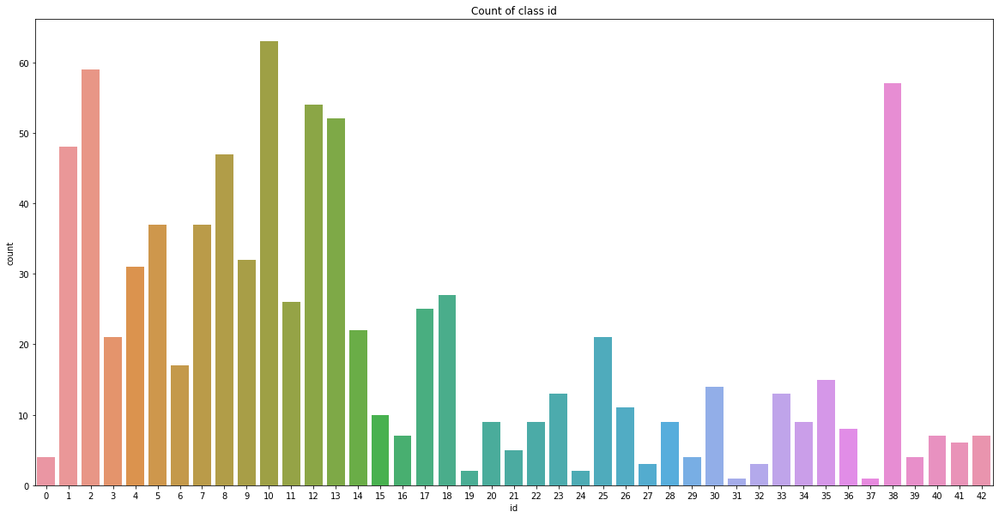

In [55]:
plt.figure(figsize=(20,10))
#plotting count plot with seaborn
sns.countplot(data['id']).set_title('Count of class id');

* The count of id's 1,2,4,10,12,13 and 38 are high in number when compared to other sign id's.
* The sign id's 0,19,31 and 38 are least in number.

In [56]:
#assigning class id's under the category mentioned in research paper.
prohibitory = [0,1,2,3,4,5,7,8,9,10,15,16]
danger = [11,18,19,20,21,22,23,24,25,26,27,28,29,30,31]
mandatory = [33,34,35,36,37,38,39,40]
other = [6,12,13,14,17,32,41,42]

In [57]:
#copying id column of data into df
df = data['id']
data ['Object Name'] = data['id']
#assigning new labels, 1 implies prohibitory,2 implies danger,3 implies mandatory and 4 implies other.
for i in range(len(df)):
  if(df[i] in prohibitory):
    df.loc[i]=0
    data['Object Name'].loc[i]='prohibitory'
  elif(df[i] in danger):
    df.loc[i]=1
    data['Object Name'].loc[i]='danger'
  elif(df[i] in mandatory):
    df.loc[i]=2
    data['Object Name'].loc[i]='mandatory'
  elif(df[i] in other):
    df.loc[i]=3
    data['Object Name'].loc[i]='other'
  else:
    df.loc[i]=-1

/usr/local/lib/python3.8/dist-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)


In [58]:
data.head()

,path,left,top,right,bottom,id,Object Name
0,00000.ppm,774,411,815,446,1,danger
1,00001.ppm,983,388,1024,432,2,mandatory
2,00001.ppm,386,494,442,552,2,mandatory
3,00001.ppm,973,335,1031,390,3,other
4,00002.ppm,892,476,1006,592,2,mandatory


/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


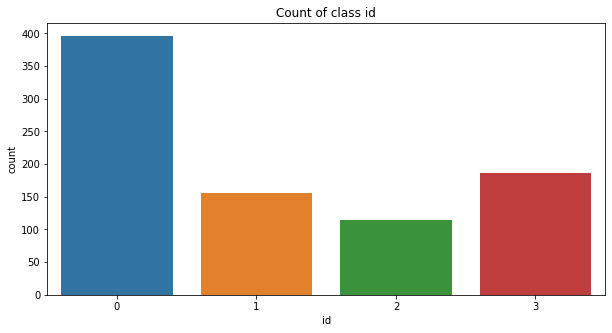

In [59]:
plt.figure(figsize=(10,5))
#plotting count plot with seaborn
sns.countplot(data['id']).set_title('Count of class id');

* We can observe that the prohibitory class id's are high in number in the dataset.

In [60]:
#!rm -rf /content/TrainIJCNN2013

In [61]:
#voc=final_df.copy()

## pixels in bounding box

In [62]:
box_size=[]
for i in range(len(data)):
  bounding = data['bottom'][i]-data['top'][i]+data['right'][i]-data['left'][i]
  box_size.append(bounding)

In [63]:
max(box_size)

246

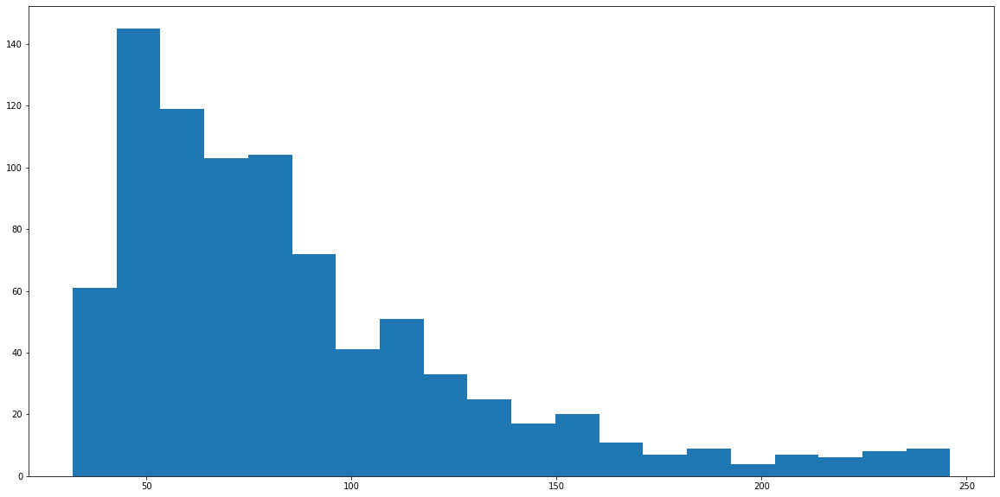

In [64]:
plt.figure(figsize=(20,10))
plt.hist(box_size, bins=20);

* We can observe that the bounding box size ranges from 32 to 248 pixels. 
* Most of the boxes lie in 40 to 100 pixel range, very less boxes are more than 150 pixels.

## Converting to jpg format and removing images without objects

In [65]:
#removing .ppm from path
for i in range(len(data)):
  data['path'][i] = data['path'][i][:-4]

<ipython-input-65-8810de1240e6>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['path'][i] = data['path'][i][:-4]


In [66]:
# Using os.walk for going through all directories
# and files in them from the current directory
import os
import cv2

path_dir="/content/TrainIJCNN2013/"
final_df=pd.DataFrame(columns=data.columns)

for current_dir, dirs, files in os.walk(path_dir):
    for f in files:
        #print(f)
        #Check if a file end with .ppm format or not
        if f.endswith('.ppm'):
            image_name=f[:-4]
            img=cv2.imread(path_dir + f)
            single_yolo_dat = data.loc[data['path'] == f].copy()
            # and, in this way, initial dataFrame will not be changed

            # Checking if there is no any annotations for current image
            if single_yolo_dat.isnull().values.all():
              final_df=final_df.append(single_yolo_dat)
              #Now writng and saving the image from ppm format to jpg format using OpenCV
              save_path = '/content/images' + '/' + image_name + '.jpg'
              cv2.imwrite(save_path, img)
              
final_df = final_df[~final_df.index.duplicated(keep='first')]
final_df.sort_index(inplace=True)     

In [67]:
%%writefile /content/obj.names
prohibitory
danger
mandatory
other

Writing /content/obj.names


## Creating xml files

In [68]:
#dataframe to xml file
#https://gist.github.com/goodhamgupta/7ca514458d24af980669b8b1c8bcdafd
import os
import xml.etree.cElementTree as ET
from PIL import Image

ANNOTATIONS_DIR_PREFIX = "images"

DESTINATION_DIR = "/content/XML"

CLASS_MAPPING = {
    '0': 'prohibitory',
    '1': 'danger',
    '2': 'mandatory',
    '3': 'other'
}

def create_root(filename, width, height):
    root = ET.Element("annotation")
    ET.SubElement(root, "folder").text = "images"
    ET.SubElement(root, "filename").text = (filename)
    ET.SubElement(root, "path").text = "images/{}".format(filename)
    source = ET.SubElement(root, "source")
    ET.SubElement(source, "database").text = "Unknown"
    size = ET.SubElement(root, "size")
    ET.SubElement(size, "width").text = str(width)
    ET.SubElement(size, "height").text = str(height)
    ET.SubElement(size, "depth").text = "3"
    ET.SubElement(root, "segmented").text = "0"
    return root

def create_object_annotation(root, voc):
    for ind,voc_label in voc.iterrows():
        obj = ET.SubElement(root, "object")
        ET.SubElement(obj, "name").text=str(CLASS_MAPPING.get(str(voc_label["id"])))
        ET.SubElement(obj, "pose").text = "Unspecified"
        ET.SubElement(obj, "truncated").text = str(0)
        ET.SubElement(obj, "difficult").text = str(0)
        bbox = ET.SubElement(obj, "bndbox")
        ET.SubElement(bbox, "xmin").text = str(voc_label["left"])
        ET.SubElement(bbox, "ymin").text = str(voc_label["top"])
        ET.SubElement(bbox, "xmax").text = str(voc_label["right"])
        ET.SubElement(bbox, "ymax").text = str(voc_label["bottom"])
    if(len(voc)==0):
      print('no')
    return root


def create_file(filename, width, height, voc):
    root = create_root(filename, width, height)
    root = create_object_annotation(root, voc)
    tree = ET.ElementTree(root)
    tree.write("{}/{}.xml".format(DESTINATION_DIR, filename[:-4]))


def read_file(filename):
    img = cv2.imread("{}/{}".format("images/", filename))
    w,h=img.shape[:2]
    voc = final_df.loc[final_df.path == filename].copy()
    voc["name"] = CLASS_MAPPING.get(str((voc["id"])))
    create_file(filename, w, h, voc)


def start():
    if not os.path.exists(DESTINATION_DIR):
        os.makedirs(DESTINATION_DIR)
    for filename in os.listdir(ANNOTATIONS_DIR_PREFIX):
          if filename.endswith(".jpg"):
            read_file(filename)

if __name__ == "__main__":
    start()

no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
no
n

# Creating tfrecord files

In [69]:
len(data)

852

In [70]:
# storing 600 images path in a for training
a = data[:600]['path']

In [71]:
#Writing image path in train file
MyFile=open('/content/imageset/train.txt','w')

for element in a:
     MyFile.write(element)
     MyFile.write('\n')
MyFile.close()

In [72]:
# storing 252 images path in a for validation
a = data[600:]['path']

In [73]:
#Writing image path in validation file
MyFile=open('/content/imageset/valid.txt','w')

for element in a:
     MyFile.write(element)
     MyFile.write('\n')
MyFile.close()

In [74]:
import time
import os
import hashlib
from absl import app, flags, logging
import tensorflow as tf
import lxml.etree
import tqdm

data_dir = '/content'
split = 'train'
output_file =  '/content/data_traffic/train.tfrecord'
classes = '/content/data_traffic/obj.names'


def build_example(annotation, class_map):
    img_path = os.path.join(
        data_dir, 'images', annotation['filename'])
    img_raw = open(img_path, 'rb').read()
    key = hashlib.sha256(img_raw).hexdigest()
    width = int(annotation['size']['height'])
    height = int(annotation['size']['width'])

    xmin = []
    ymin = []
    xmax = []
    ymax = []
    classes = []
    classes_text = []
    truncated = []
    views = []
    difficult_obj = []
    if 'object' in annotation:
        for obj in annotation['object']:
            difficult = bool(int(obj['difficult']))
            difficult_obj.append(int(difficult))

            xmin.append(float(obj['bndbox']['xmin']) / width)
            ymin.append(float(obj['bndbox']['ymin']) / height)
            xmax.append(float(obj['bndbox']['xmax']) / width)
            ymax.append(float(obj['bndbox']['ymax']) / height)
            classes_text.append(obj['name'].encode('utf8'))
            classes.append(class_map[obj['name']])
            truncated.append(int(obj['truncated']))
            views.append(obj['pose'].encode('utf8'))

    example = tf.train.Example(features=tf.train.Features(feature={
        'image/height': tf.train.Feature(int64_list=tf.train.Int64List(value=[height])),
        'image/width': tf.train.Feature(int64_list=tf.train.Int64List(value=[width])),
        'image/filename': tf.train.Feature(bytes_list=tf.train.BytesList(value=[
            annotation['filename'].encode('utf8')])),
        'image/source_id': tf.train.Feature(bytes_list=tf.train.BytesList(value=[
            annotation['filename'].encode('utf8')])),
        'image/key/sha256': tf.train.Feature(bytes_list=tf.train.BytesList(value=[key.encode('utf8')])),
        'image/encoded': tf.train.Feature(bytes_list=tf.train.BytesList(value=[img_raw])),
        'image/format': tf.train.Feature(bytes_list=tf.train.BytesList(value=['jpeg'.encode('utf8')])),
        'image/object/bbox/xmin': tf.train.Feature(float_list=tf.train.FloatList(value=xmin)),
        'image/object/bbox/xmax': tf.train.Feature(float_list=tf.train.FloatList(value=xmax)),
        'image/object/bbox/ymin': tf.train.Feature(float_list=tf.train.FloatList(value=ymin)),
        'image/object/bbox/ymax': tf.train.Feature(float_list=tf.train.FloatList(value=ymax)),
        'image/object/class/text': tf.train.Feature(bytes_list=tf.train.BytesList(value=classes_text)),
        'image/object/class/label': tf.train.Feature(int64_list=tf.train.Int64List(value=classes)),
        'image/object/difficult': tf.train.Feature(int64_list=tf.train.Int64List(value=difficult_obj)),
        'image/object/truncated': tf.train.Feature(int64_list=tf.train.Int64List(value=truncated)),
        'image/object/view': tf.train.Feature(bytes_list=tf.train.BytesList(value=views)),
    }))
    return example


def parse_xml(xml):
    if not len(xml):
        return {xml.tag: xml.text}
    result = {}
    for child in xml:
        child_result = parse_xml(child)
        if child.tag != 'object':
            result[child.tag] = child_result[child.tag]
        else:
            if child.tag not in result:
                result[child.tag] = []
            result[child.tag].append(child_result[child.tag])
    return {xml.tag: result}


class_map = {name: idx for idx, name in enumerate(
    open(classes).read().splitlines())}
logging.info("Class mapping loaded: %s", class_map)

writer = tf.io.TFRecordWriter(output_file)
image_list = open(os.path.join(
    data_dir, 'imageset', '%s.txt' %split)).read().splitlines()
logging.info("Image list loaded: %d", len(image_list))
for name in tqdm.tqdm(image_list):
    annotation_xml = os.path.join(
        data_dir, 'XML', name + '.xml')
    annotation_xml = lxml.etree.fromstring(open(annotation_xml).read())
    annotation = parse_xml(annotation_xml)['annotation']
    tf_example = build_example(annotation, class_map)
    writer.write(tf_example.SerializeToString())
writer.close()
logging.info("Done")


100%|██████████| 600/600 [00:01<00:00, 316.12it/s]


In [75]:
# reading a sample .tfrecord file
# raw_dataset = tf.data.TFRecordDataset("/content/data_traffic/train.tfrecord")
# raw_dataset = raw_dataset.shuffle(512)
# for raw_record in raw_dataset.take(1):
#     example = tf.train.Example()
#     example.ParseFromString(raw_record.numpy())
#     print(example)

In [76]:
import time
import os
import hashlib
from absl import app, flags, logging
import tensorflow as tf
import lxml.etree
import tqdm

data_dir = '/content'
split = 'valid'
output_file =  '/content/data_traffic/valid.tfrecord'
classes = '/content/data_traffic/obj.names'


def build_example(annotation, class_map):
    img_path = os.path.join(
        data_dir, 'images', annotation['filename'])
    img_raw = open(img_path, 'rb').read()
    key = hashlib.sha256(img_raw).hexdigest()
    width = int(annotation['size']['height'])
    height = int(annotation['size']['width'])

    xmin = []
    ymin = []
    xmax = []
    ymax = []
    classes = []
    classes_text = []
    truncated = []
    views = []
    difficult_obj = []
    if 'object' in annotation:
        for obj in annotation['object']:
            difficult = bool(int(obj['difficult']))
            difficult_obj.append(int(difficult))

            xmin.append(float(obj['bndbox']['xmin']) / width)
            ymin.append(float(obj['bndbox']['ymin']) / height)
            xmax.append(float(obj['bndbox']['xmax']) / width)
            ymax.append(float(obj['bndbox']['ymax']) / height)
            classes_text.append(obj['name'].encode('utf8'))
            classes.append(class_map[obj['name']])
            truncated.append(int(obj['truncated']))
            views.append(obj['pose'].encode('utf8'))

    example = tf.train.Example(features=tf.train.Features(feature={
        'image/height': tf.train.Feature(int64_list=tf.train.Int64List(value=[height])),
        'image/width': tf.train.Feature(int64_list=tf.train.Int64List(value=[width])),
        'image/filename': tf.train.Feature(bytes_list=tf.train.BytesList(value=[
            annotation['filename'].encode('utf8')])),
        'image/source_id': tf.train.Feature(bytes_list=tf.train.BytesList(value=[
            annotation['filename'].encode('utf8')])),
        'image/key/sha256': tf.train.Feature(bytes_list=tf.train.BytesList(value=[key.encode('utf8')])),
        'image/encoded': tf.train.Feature(bytes_list=tf.train.BytesList(value=[img_raw])),
        'image/format': tf.train.Feature(bytes_list=tf.train.BytesList(value=['jpeg'.encode('utf8')])),
        'image/object/bbox/xmin': tf.train.Feature(float_list=tf.train.FloatList(value=xmin)),
        'image/object/bbox/xmax': tf.train.Feature(float_list=tf.train.FloatList(value=xmax)),
        'image/object/bbox/ymin': tf.train.Feature(float_list=tf.train.FloatList(value=ymin)),
        'image/object/bbox/ymax': tf.train.Feature(float_list=tf.train.FloatList(value=ymax)),
        'image/object/class/text': tf.train.Feature(bytes_list=tf.train.BytesList(value=classes_text)),
        'image/object/class/label': tf.train.Feature(int64_list=tf.train.Int64List(value=classes)),
        'image/object/difficult': tf.train.Feature(int64_list=tf.train.Int64List(value=difficult_obj)),
        'image/object/truncated': tf.train.Feature(int64_list=tf.train.Int64List(value=truncated)),
        'image/object/view': tf.train.Feature(bytes_list=tf.train.BytesList(value=views)),
    }))
    return example


def parse_xml(xml):
    if not len(xml):
        return {xml.tag: xml.text}
    result = {}
    for child in xml:
        child_result = parse_xml(child)
        if child.tag != 'object':
            result[child.tag] = child_result[child.tag]
        else:
            if child.tag not in result:
                result[child.tag] = []
            result[child.tag].append(child_result[child.tag])
    return {xml.tag: result}


class_map = {name: idx for idx, name in enumerate(
    open(classes).read().splitlines())}
logging.info("Class mapping loaded: %s", class_map)

writer = tf.io.TFRecordWriter(output_file)
image_list = open(os.path.join(
    data_dir, 'imageset', '%s.txt' %split)).read().splitlines()
logging.info("Image list loaded: %d", len(image_list))
for name in tqdm.tqdm(image_list):
    annotation_xml = os.path.join(
        data_dir, 'XML', name + '.xml')
    annotation_xml = lxml.etree.fromstring(open(annotation_xml).read())
    annotation = parse_xml(annotation_xml)['annotation']
    tf_example = build_example(annotation, class_map)
    writer.write(tf_example.SerializeToString())
writer.close()
logging.info("Done")

100%|██████████| 252/252 [00:00<00:00, 363.96it/s]


## tfrecord utility functions

In [77]:
import tensorflow as tf
from absl.flags import FLAGS
yolo_max_boxes =  100
@tf.function
def transform_targets_for_output(y_true, grid_size, anchor_idxs):
    # y_true: (N, boxes, (x1, y1, x2, y2, class, best_anchor))
    N = tf.shape(y_true)[0]

    # y_true_out: (N, grid, grid, anchors, [x, y, w, h, obj, class])
    y_true_out = tf.zeros(
        (N, grid_size, grid_size, tf.shape(anchor_idxs)[0], 6))

    anchor_idxs = tf.cast(anchor_idxs, tf.int32)

    indexes = tf.TensorArray(tf.int32, 1, dynamic_size=True)
    updates = tf.TensorArray(tf.float32, 1, dynamic_size=True)
    idx = 0
    for i in tf.range(N):
        for j in tf.range(tf.shape(y_true)[1]):
            if tf.equal(y_true[i][j][2], 0):
                continue
            anchor_eq = tf.equal(
                anchor_idxs, tf.cast(y_true[i][j][5], tf.int32))

            if tf.reduce_any(anchor_eq):
                box = y_true[i][j][0:4]
                box_xy = (y_true[i][j][0:2] + y_true[i][j][2:4]) / 2

                anchor_idx = tf.cast(tf.where(anchor_eq), tf.int32)
                grid_xy = tf.cast(box_xy // (1/grid_size), tf.int32)

                # grid[y][x][anchor] = (tx, ty, bw, bh, obj, class)
                indexes = indexes.write(
                    idx, [i, grid_xy[1], grid_xy[0], anchor_idx[0][0]])
                updates = updates.write(
                    idx, [box[0], box[1], box[2], box[3], 1, y_true[i][j][4]])
                idx += 1

    # tf.print(indexes.stack())
    # tf.print(updates.stack())

    return tf.tensor_scatter_nd_update(
        y_true_out, indexes.stack(), updates.stack())


def transform_targets(y_train, anchors, anchor_masks, size):
    y_outs = []
    grid_size = size // 32
    
    # calculate anchor index for true boxes
    anchors = tf.cast(anchors, tf.float32)
    anchor_area = anchors[..., 0] * anchors[..., 1]
    box_wh = y_train[..., 2:4] - y_train[..., 0:2]
    box_wh = tf.tile(tf.expand_dims(box_wh, -2),
                     (1, 1, tf.shape(anchors)[0], 1))
    box_area = box_wh[..., 0] * box_wh[..., 1]
    intersection = tf.minimum(box_wh[..., 0], anchors[..., 0]) * \
        tf.minimum(box_wh[..., 1], anchors[..., 1])
    iou = intersection / (box_area + anchor_area - intersection)
    anchor_idx = tf.cast(tf.argmax(iou, axis=-1), tf.float32)
    anchor_idx = tf.expand_dims(anchor_idx, axis=-1)

    y_train = tf.concat([y_train, anchor_idx], axis=-1)

    for anchor_idxs in anchor_masks:
        y_outs.append(transform_targets_for_output(
            y_train, grid_size, anchor_idxs))
        grid_size *= 2

    return tuple(y_outs)


def transform_images(x_train, size):
    x_train = tf.image.resize(x_train, (size, size))
    x_train = x_train / 255
    return x_train


# https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/using_your_own_dataset.md#conversion-script-outline-conversion-script-outline
# Commented out fields are not required in our project
IMAGE_FEATURE_MAP = {
    # 'image/width': tf.io.FixedLenFeature([], tf.int64),
    # 'image/height': tf.io.FixedLenFeature([], tf.int64),
    # 'image/filename': tf.io.FixedLenFeature([], tf.string),
    # 'image/source_id': tf.io.FixedLenFeature([], tf.string),
    # 'image/key/sha256': tf.io.FixedLenFeature([], tf.string),
    'image/encoded': tf.io.FixedLenFeature([], tf.string),
    # 'image/format': tf.io.FixedLenFeature([], tf.string),
    'image/object/bbox/xmin': tf.io.VarLenFeature(tf.float32),
    'image/object/bbox/ymin': tf.io.VarLenFeature(tf.float32),
    'image/object/bbox/xmax': tf.io.VarLenFeature(tf.float32),
    'image/object/bbox/ymax': tf.io.VarLenFeature(tf.float32),
    'image/object/class/text': tf.io.VarLenFeature(tf.string),
    # 'image/object/class/label': tf.io.VarLenFeature(tf.int64),
    # 'image/object/difficult': tf.io.VarLenFeature(tf.int64),
    # 'image/object/truncated': tf.io.VarLenFeature(tf.int64),
    # 'image/object/view': tf.io.VarLenFeature(tf.string),
}


def parse_tfrecord(tfrecord, class_table, size):
    x = tf.io.parse_single_example(tfrecord, IMAGE_FEATURE_MAP)
    x_train = tf.image.decode_jpeg(x['image/encoded'], channels=3)
    x_train = tf.image.resize(x_train, (size, size))

    class_text = tf.sparse.to_dense(
        x['image/object/class/text'], default_value='')
    labels = tf.cast(class_table.lookup(class_text), tf.float32)
    y_train = tf.stack([tf.sparse.to_dense(x['image/object/bbox/xmin']),
                        tf.sparse.to_dense(x['image/object/bbox/ymin']),
                        tf.sparse.to_dense(x['image/object/bbox/xmax']),
                        tf.sparse.to_dense(x['image/object/bbox/ymax']),
                        labels], axis=1)

    paddings = [[0, yolo_max_boxes - tf.shape(y_train)[0]], [0, 0]]
    y_train = tf.pad(y_train, paddings)

    return x_train, y_train


def load_tfrecord_dataset(file_pattern, class_file, size=416):
    LINE_NUMBER = -1  # TODO: use tf.lookup.TextFileIndex.LINE_NUMBER
    class_table = tf.lookup.StaticHashTable(tf.lookup.TextFileInitializer(
        class_file, tf.string, 0, tf.int64, LINE_NUMBER, delimiter="\n"), -1)

    files = tf.data.Dataset.list_files(file_pattern)
    dataset = files.flat_map(tf.data.TFRecordDataset)
    return dataset.map(lambda x: parse_tfrecord(x, class_table, size))


def load_fake_dataset():
    x_train = tf.image.decode_jpeg(
        open('./data/girl.png', 'rb').read(), channels=3)
    x_train = tf.expand_dims(x_train, axis=0)

    labels = [
        [0.18494931, 0.03049111, 0.9435849,  0.96302897, 0],
        [0.01586703, 0.35938117, 0.17582396, 0.6069674, 56],
        [0.09158827, 0.48252046, 0.26967454, 0.6403017, 67]
    ] + [[0, 0, 0, 0, 0]] * 5
    y_train = tf.convert_to_tensor(labels, tf.float32)
    y_train = tf.expand_dims(y_train, axis=0)

    return tf.data.Dataset.from_tensor_slices((x_train, y_train))

## Drawing bounding boxes in images

In [78]:
def draw_outputs(img, outputs, class_names):
    boxes, objectness, classes, nums = outputs
    boxes, objectness, classes, nums = boxes[0], objectness[0], classes[0], nums[0]
    wh = np.flip(img.shape[0:2])
    for i in range(nums):
        x1y1 = tuple((np.array(boxes[i][0:2]) * wh).astype(np.int32))
        x2y2 = tuple((np.array(boxes[i][2:4]) * wh).astype(np.int32))
        img = cv2.rectangle(img, x1y1, x2y2, (255, 0, 0), 2)
        img = cv2.putText(img, '{} {:.4f}'.format(
            class_names[int(classes[i])][0], objectness[i]),
            x1y1, cv2.FONT_HERSHEY_COMPLEX_SMALL, 1, (0, 0, 255), 2)
        
    return img

In [79]:
import cv2
import numpy as np
from absl import app, flags, logging
data_dir = '/content/data_traffic'
size = 416
dataset =  '/content/data_traffic/train.tfrecord'
classes = '/content/data_traffic/obj.names'


class_names = [c.strip() for c in open(classes).readlines()]

dataset = load_tfrecord_dataset(dataset, classes, size)
i=1
for image, labels in dataset.take(30):
    boxes = []
    scores = []
    classes = []
    
    output = '/content/data_traffic/output'+str(i)+'.jpg'
    for x1, y1, x2, y2, label in labels:
        if x1 == 0 and x2 == 0:
            continue

        boxes.append((x1, y1, x2, y2))
        scores.append(1)
        classes.append(label)
    nums = [len(boxes)]
    boxes = [boxes]
    scores = [scores]
    classes = [classes]

    img = cv2.cvtColor(image.numpy(), cv2.COLOR_RGB2BGR)
    img = draw_outputs(img, (boxes, scores, classes, nums), class_names)
    cv2.imwrite(output, img)
    print(output)
    i=i+1


/content/data_traffic/output1.jpg
/content/data_traffic/output2.jpg
/content/data_traffic/output3.jpg
/content/data_traffic/output4.jpg
/content/data_traffic/output5.jpg
/content/data_traffic/output6.jpg
/content/data_traffic/output7.jpg
/content/data_traffic/output8.jpg
/content/data_traffic/output9.jpg
/content/data_traffic/output10.jpg
/content/data_traffic/output11.jpg
/content/data_traffic/output12.jpg
/content/data_traffic/output13.jpg
/content/data_traffic/output14.jpg
/content/data_traffic/output15.jpg
/content/data_traffic/output16.jpg
/content/data_traffic/output17.jpg
/content/data_traffic/output18.jpg
/content/data_traffic/output19.jpg
/content/data_traffic/output20.jpg
/content/data_traffic/output21.jpg
/content/data_traffic/output22.jpg
/content/data_traffic/output23.jpg
/content/data_traffic/output24.jpg
/content/data_traffic/output25.jpg
/content/data_traffic/output26.jpg
/content/data_traffic/output27.jpg
/content/data_traffic/output28.jpg
/content/data_traffic/output2

In [80]:
!zip -r images.zip /content/data_traffic

  adding: content/data_traffic/ (stored 0%)
  adding: content/data_traffic/output3.jpg (deflated 1%)
  adding: content/data_traffic/output27.jpg (deflated 0%)
  adding: content/data_traffic/output22.jpg (deflated 0%)
  adding: content/data_traffic/output20.jpg (deflated 0%)
  adding: content/data_traffic/output7.jpg (deflated 0%)
  adding: content/data_traffic/output23.jpg (deflated 0%)
  adding: content/data_traffic/output5.jpg (deflated 1%)
  adding: content/data_traffic/train.tfrecord (deflated 1%)
  adding: content/data_traffic/output28.jpg (deflated 1%)
  adding: content/data_traffic/output18.jpg (deflated 0%)
  adding: content/data_traffic/output2.jpg (deflated 1%)
  adding: content/data_traffic/output4.jpg (deflated 1%)
  adding: content/data_traffic/output15.jpg (deflated 0%)
  adding: content/data_traffic/valid.tfrecord (deflated 1%)
  adding: content/data_traffic/output6.jpg (deflated 0%)
  adding: content/data_traffic/output26.jpg (deflated 0%)
  adding: content/data_traffic

In [81]:
#Downloading weights
!curl --header 'Host: pjreddie.com' --user-agent 'Mozilla/5.0 (Windows NT 10.0; Win64; x64; rv:80.0) Gecko/20100101 Firefox/80.0' --header 'Accept: text/html,application/xhtml+xml,application/xml;q=0.9,image/webp,*/*;q=0.8' --header 'Accept-Language: en-US,en;q=0.5' --header 'Upgrade-Insecure-Requests: 1' 'https://pjreddie.com/media/files/yolov3.weights' --output 'yolov3.weights'

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  236M  100  236M    0     0  41.7M      0  0:00:05  0:00:05 --:--:-- 51.9M


In [82]:
#zipping file for future use
!zip -r /content/yolo_v3_aug_correct.zip /content/data_traffic_aug

	zip warning: name not matched: /content/data_traffic_aug

zip error: Nothing to do! (try: zip -r /content/yolo_v3_aug_correct.zip . -i /content/data_traffic_aug)


In [83]:
def broadcast_iou(box_1, box_2):
    # box_1: (..., (x1, y1, x2, y2))
    # box_2: (N, (x1, y1, x2, y2))

    # broadcast boxes
    box_1 = tf.expand_dims(box_1, -2)
    box_2 = tf.expand_dims(box_2, 0)
    # new_shape: (..., N, (x1, y1, x2, y2))
    new_shape = tf.broadcast_dynamic_shape(tf.shape(box_1), tf.shape(box_2))
    box_1 = tf.broadcast_to(box_1, new_shape)
    box_2 = tf.broadcast_to(box_2, new_shape)

    int_w = tf.maximum(tf.minimum(box_1[..., 2], box_2[..., 2]) -
                       tf.maximum(box_1[..., 0], box_2[..., 0]), 0)
    int_h = tf.maximum(tf.minimum(box_1[..., 3], box_2[..., 3]) -
                       tf.maximum(box_1[..., 1], box_2[..., 1]), 0)
    int_area = int_w * int_h
    box_1_area = (box_1[..., 2] - box_1[..., 0]) * \
        (box_1[..., 3] - box_1[..., 1])
    box_2_area = (box_2[..., 2] - box_2[..., 0]) * \
        (box_2[..., 3] - box_2[..., 1])
    return int_area / (box_1_area + box_2_area - int_area)

## model creation and adding weights

In [84]:
import numpy as np
import tensorflow as tf
from tensorflow.keras import Model
from tensorflow.keras.layers import (
    Add,
    Concatenate,
    Conv2D,
    Input,
    Lambda,
    LeakyReLU,
    MaxPool2D,
    UpSampling2D,
    ZeroPadding2D,
    BatchNormalization,
)
from tensorflow.keras.regularizers import l2
from tensorflow.keras.losses import (
    binary_crossentropy,
    sparse_categorical_crossentropy
)


yolo_max_boxes = 100
yolo_iou_threshold = 0.4
yolo_score_threshold = 0.4

yolo_anchors = np.array([(10, 13), (16, 30), (33, 23), (30, 61), (62, 45),
                         (59, 119), (116, 90), (156, 198), (373, 326)],
                        np.float32) / 416
yolo_anchor_masks = np.array([[6, 7, 8], [3, 4, 5], [0, 1, 2]])

yolo_tiny_anchors = np.array([(10, 14), (23, 27), (37, 58),
                              (81, 82), (135, 169),  (344, 319)],
                             np.float32) / 416
yolo_tiny_anchor_masks = np.array([[3, 4, 5], [0, 1, 2]])


def DarknetConv(x, filters, size, strides=1, batch_norm=True):
    if strides == 1:
        padding = 'same'
    else:
        x = ZeroPadding2D(((1, 0), (1, 0)))(x)  # top left half-padding
        padding = 'valid'
    x = Conv2D(filters=filters, kernel_size=size,
               strides=strides, padding=padding,
               use_bias=not batch_norm, kernel_regularizer=l2(0.0005))(x)
    if batch_norm:
        x = BatchNormalization()(x)
        x = LeakyReLU(alpha=0.1)(x)
    return x


def DarknetResidual(x, filters):
    prev = x
    x = DarknetConv(x, filters // 2, 1)
    x = DarknetConv(x, filters, 3)
    x = Add()([prev, x])
    return x


def DarknetBlock(x, filters, blocks):
    x = DarknetConv(x, filters, 3, strides=2)
    for _ in range(blocks):
        x = DarknetResidual(x, filters)
    return x


def Darknet(name=None):
    x = inputs = Input([None, None, 3])
    x = DarknetConv(x, 32, 3)
    x = DarknetBlock(x, 64, 1)
    x = DarknetBlock(x, 128, 2)  # skip connection
    x = x_36 = DarknetBlock(x, 256, 8)  # skip connection
    x = x_61 = DarknetBlock(x, 512, 8)
    x = DarknetBlock(x, 1024, 4)
    return tf.keras.Model(inputs, (x_36, x_61, x), name=name)


def DarknetTiny(name=None):
    x = inputs = Input([None, None, 3])
    x = DarknetConv(x, 16, 3)
    x = MaxPool2D(2, 2, 'same')(x)
    x = DarknetConv(x, 32, 3)
    x = MaxPool2D(2, 2, 'same')(x)
    x = DarknetConv(x, 64, 3)
    x = MaxPool2D(2, 2, 'same')(x)
    x = DarknetConv(x, 128, 3)
    x = MaxPool2D(2, 2, 'same')(x)
    x = x_8 = DarknetConv(x, 256, 3)  # skip connection
    x = MaxPool2D(2, 2, 'same')(x)
    x = DarknetConv(x, 512, 3)
    x = MaxPool2D(2, 1, 'same')(x)
    x = DarknetConv(x, 1024, 3)
    return tf.keras.Model(inputs, (x_8, x), name=name)


def YoloConv(filters, name=None):
    def yolo_conv(x_in):
        if isinstance(x_in, tuple):
            inputs = Input(x_in[0].shape[1:]), Input(x_in[1].shape[1:])
            x, x_skip = inputs

            # concat with skip connection
            x = DarknetConv(x, filters, 1)
            x = UpSampling2D(2)(x)
            x = Concatenate()([x, x_skip])
        else:
            x = inputs = Input(x_in.shape[1:])

        x = DarknetConv(x, filters, 1)
        x = DarknetConv(x, filters * 2, 3)
        x = DarknetConv(x, filters, 1)
        x = DarknetConv(x, filters * 2, 3)
        x = DarknetConv(x, filters, 1)
        return Model(inputs, x, name=name)(x_in)
    return yolo_conv


def YoloConvTiny(filters, name=None):
    def yolo_conv(x_in):
        if isinstance(x_in, tuple):
            inputs = Input(x_in[0].shape[1:]), Input(x_in[1].shape[1:])
            x, x_skip = inputs

            # concat with skip connection
            x = DarknetConv(x, filters, 1)
            x = UpSampling2D(2)(x)
            x = Concatenate()([x, x_skip])
        else:
            x = inputs = Input(x_in.shape[1:])
            x = DarknetConv(x, filters, 1)

        return Model(inputs, x, name=name)(x_in)
    return yolo_conv


def YoloOutput(filters, anchors, classes, name=None):
    def yolo_output(x_in):
        x = inputs = Input(x_in.shape[1:])
        x = DarknetConv(x, filters * 2, 3)
        x = DarknetConv(x, anchors * (classes + 5), 1, batch_norm=False)
        x = Lambda(lambda x: tf.reshape(x, (-1, tf.shape(x)[1], tf.shape(x)[2],
                                            anchors, classes + 5)))(x)
        return tf.keras.Model(inputs, x, name=name)(x_in)
    return yolo_output


def yolo_boxes(pred, anchors, classes):
    # pred: (batch_size, grid, grid, anchors, (x, y, w, h, obj, ...classes))
    grid_size = tf.shape(pred)[1:3]
    box_xy, box_wh, objectness, class_probs = tf.split(
        pred, (2, 2, 1, classes), axis=-1)

    box_xy = tf.sigmoid(box_xy)
    objectness = tf.sigmoid(objectness)
    class_probs = tf.sigmoid(class_probs)
    pred_box = tf.concat((box_xy, box_wh), axis=-1)  # original xywh for loss

    # !!! grid[x][y] == (y, x)
    grid = tf.meshgrid(tf.range(grid_size[1]), tf.range(grid_size[0]))
    grid = tf.expand_dims(tf.stack(grid, axis=-1), axis=2)  # [gx, gy, 1, 2]

    box_xy = (box_xy + tf.cast(grid, tf.float32)) / \
        tf.cast(grid_size, tf.float32)
    box_wh = tf.exp(box_wh) * anchors

    box_x1y1 = box_xy - box_wh / 2
    box_x2y2 = box_xy + box_wh / 2
    bbox = tf.concat([box_x1y1, box_x2y2], axis=-1)

    return bbox, objectness, class_probs, pred_box


def yolo_nms(outputs, anchors, masks, classes):
    # boxes, conf, type
    b, c, t = [], [], []

    for o in outputs:
        b.append(tf.reshape(o[0], (tf.shape(o[0])[0], -1, tf.shape(o[0])[-1])))
        c.append(tf.reshape(o[1], (tf.shape(o[1])[0], -1, tf.shape(o[1])[-1])))
        t.append(tf.reshape(o[2], (tf.shape(o[2])[0], -1, tf.shape(o[2])[-1])))

    bbox = tf.concat(b, axis=1)
    confidence = tf.concat(c, axis=1)
    class_probs = tf.concat(t, axis=1)

    scores = confidence * class_probs
    boxes, scores, classes, valid_detections = tf.image.combined_non_max_suppression(
        boxes=tf.reshape(bbox, (tf.shape(bbox)[0], -1, 1, 4)),
        scores=tf.reshape(
            scores, (tf.shape(scores)[0], -1, tf.shape(scores)[-1])),
        max_output_size_per_class=yolo_max_boxes,
        max_total_size=yolo_max_boxes,
        iou_threshold=yolo_iou_threshold,
        score_threshold=yolo_score_threshold
    )

    return boxes, scores, classes, valid_detections


def YoloV3(size=None, channels=3, anchors=yolo_anchors,
           masks=yolo_anchor_masks, classes=4, training=False):
    x = inputs = Input([size, size, channels], name='input')

    x_36, x_61, x = Darknet(name='yolo_darknet')(x)

    x = YoloConv(512, name='yolo_conv_0')(x)
    output_0 = YoloOutput(512, len(masks[0]), classes, name='yolo_output_0')(x)

    x = YoloConv(256, name='yolo_conv_1')((x, x_61))
    output_1 = YoloOutput(256, len(masks[1]), classes, name='yolo_output_1')(x)

    x = YoloConv(128, name='yolo_conv_2')((x, x_36))
    output_2 = YoloOutput(128, len(masks[2]), classes, name='yolo_output_2')(x)

    if training:
        return Model(inputs, (output_0, output_1, output_2), name='yolov3')

    boxes_0 = Lambda(lambda x: yolo_boxes(x, anchors[masks[0]], classes),
                     name='yolo_boxes_0')(output_0)
    boxes_1 = Lambda(lambda x: yolo_boxes(x, anchors[masks[1]], classes),
                     name='yolo_boxes_1')(output_1)
    boxes_2 = Lambda(lambda x: yolo_boxes(x, anchors[masks[2]], classes),
                     name='yolo_boxes_2')(output_2)

    outputs = Lambda(lambda x: yolo_nms(x, anchors, masks, classes),
                     name='yolo_nms')((boxes_0[:3], boxes_1[:3], boxes_2[:3]))

    return Model(inputs, outputs, name='yolov3')


def YoloLoss(anchors, classes=80, ignore_thresh=0.5):
    def yolo_loss(y_true, y_pred):
        # 1. transform all pred outputs
        # y_pred: (batch_size, grid, grid, anchors, (x, y, w, h, obj, ...cls))
        pred_box, pred_obj, pred_class, pred_xywh = yolo_boxes(
            y_pred, anchors, classes)
        pred_xy = pred_xywh[..., 0:2]
        pred_wh = pred_xywh[..., 2:4]

        # 2. transform all true outputs
        # y_true: (batch_size, grid, grid, anchors, (x1, y1, x2, y2, obj, cls))
        true_box, true_obj, true_class_idx = tf.split(
            y_true, (4, 1, 1), axis=-1)
        true_xy = (true_box[..., 0:2] + true_box[..., 2:4]) / 2
        true_wh = true_box[..., 2:4] - true_box[..., 0:2]

        # give higher weights to small boxes
        box_loss_scale = 2 - true_wh[..., 0] * true_wh[..., 1]

        # 3. inverting the pred box equations
        grid_size = tf.shape(y_true)[1]
        grid = tf.meshgrid(tf.range(grid_size), tf.range(grid_size))
        grid = tf.expand_dims(tf.stack(grid, axis=-1), axis=2)
        true_xy = true_xy * tf.cast(grid_size, tf.float32) - \
            tf.cast(grid, tf.float32)
        true_wh = tf.math.log(true_wh / anchors)
        true_wh = tf.where(tf.math.is_inf(true_wh),
                           tf.zeros_like(true_wh), true_wh)

        # 4. calculate all masks
        obj_mask = tf.squeeze(true_obj, -1)
        # ignore false positive when iou is over threshold
        best_iou = tf.map_fn(
            lambda x: tf.reduce_max(broadcast_iou(x[0], tf.boolean_mask(
                x[1], tf.cast(x[2], tf.bool))), axis=-1),
            (pred_box, true_box, obj_mask),
            tf.float32)
        ignore_mask = tf.cast(best_iou < ignore_thresh, tf.float32)

        # 5. calculate all losses
        xy_loss = obj_mask * box_loss_scale * \
            tf.reduce_sum(tf.square(true_xy - pred_xy), axis=-1)
        wh_loss = obj_mask * box_loss_scale * \
            tf.reduce_sum(tf.square(true_wh - pred_wh), axis=-1)
        obj_loss = binary_crossentropy(true_obj, pred_obj)
        obj_loss = obj_mask * obj_loss + \
            (1 - obj_mask) * ignore_mask * obj_loss
        # TODO: use binary_crossentropy instead
        class_loss = obj_mask * sparse_categorical_crossentropy(
            true_class_idx, pred_class)

        # 6. sum over (batch, gridx, gridy, anchors) => (batch, 1)
        xy_loss = tf.reduce_sum(xy_loss, axis=(1, 2, 3))
        wh_loss = tf.reduce_sum(wh_loss, axis=(1, 2, 3))
        obj_loss = tf.reduce_sum(obj_loss, axis=(1, 2, 3))
        class_loss = tf.reduce_sum(class_loss, axis=(1, 2, 3))

        return xy_loss + wh_loss + obj_loss + class_loss
    return yolo_loss

In [85]:
from absl import app, flags, logging
YOLOV3_LAYER_LIST = [
    'yolo_darknet',
    'yolo_conv_0',
    'yolo_output_0',
    'yolo_conv_1',
    'yolo_output_1',
    'yolo_conv_2',
    'yolo_output_2',
]


def load_darknet_weights(model, weights_file, tiny=False):
    wf = open(weights_file, 'rb')
    major, minor, revision, seen, _ = np.fromfile(wf, dtype=np.int32, count=5)

    if tiny:
        layers = YOLOV3_TINY_LAYER_LIST
    else:
        layers = YOLOV3_LAYER_LIST

    for layer_name in layers:
        sub_model = model.get_layer(layer_name)
        for i, layer in enumerate(sub_model.layers):
            if not layer.name.startswith('conv2d'):
                continue
            batch_norm = None
            if i + 1 < len(sub_model.layers) and \
                    sub_model.layers[i + 1].name.startswith('batch_norm'):
                batch_norm = sub_model.layers[i + 1]

            logging.info("{}/{} {}".format(
                sub_model.name, layer.name, 'bn' if batch_norm else 'bias'))

            filters = layer.filters
            size = layer.kernel_size[0]
            in_dim = layer.get_input_shape_at(0)[-1]

            if batch_norm is None:
                conv_bias = np.fromfile(wf, dtype=np.float32, count=filters)
            else:
                # darknet [beta, gamma, mean, variance]
                bn_weights = np.fromfile(
                    wf, dtype=np.float32, count=4 * filters)
                # tf [gamma, beta, mean, variance]
                bn_weights = bn_weights.reshape((4, filters))[[1, 0, 2, 3]]

            # darknet shape (out_dim, in_dim, height, width)
            conv_shape = (filters, in_dim, size, size)
            conv_weights = np.fromfile(
                wf, dtype=np.float32, count=np.product(conv_shape))
            # tf shape (height, width, in_dim, out_dim)
            conv_weights = conv_weights.reshape(
                conv_shape).transpose([2, 3, 1, 0])

            if batch_norm is None:
                layer.set_weights([conv_weights, conv_bias])
            else:
                layer.set_weights([conv_weights])
                batch_norm.set_weights(bn_weights)

    assert len(wf.read()) == 0, 'failed to read all data'
    wf.close()

In [86]:
from absl import app, flags, logging
weights = '/content/yolov3.weights'
output1 = '/content/yolov3_train1.h5'
tiny = False
num_classes = 80

physical_devices = tf.config.experimental.list_physical_devices('GPU')

if tiny:
    yolo = YoloV3Tiny(classes=num_classes)
else:
    yolo = YoloV3(classes=num_classes)
yolo.summary()
logging.info('model created')

load_darknet_weights(yolo, weights, tiny)
logging.info('weights loaded')

img = np.random.random((1, 320, 320, 3)).astype(np.float32)
output = yolo(img)
logging.info('sanity check passed')

yolo.save_weights(output1)
logging.info('weights saved')



Model: "yolov3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input (InputLayer)             [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 yolo_darknet (Functional)      ((None, None, None,  40620640    ['input[0][0]']                  
                                 256),                                                            
                                 (None, None, None,                                               
                                 512),                                                            
                                 (None, None, None,                                          

In [87]:
def freeze_all(model, frozen=True):
    model.trainable = not frozen
    if isinstance(model, tf.keras.Model):
        for l in model.layers:
            freeze_all(l, frozen)

## Model Training

In [88]:
#!rm -rf '/content/drive/My Drive/traffic/logs/tensor_logs_scheduler_5_5_9'

In [89]:
%cd /content/drive/My Drive/traffic

/content/drive/My Drive/traffic


In [90]:
!git clone https://github.com/ultralytics/yolov3  # clone
%cd /content/drive/My Drive/traffic

import torch
from yolov3 import utils

fatal: destination path 'yolov3' already exists and is not an empty directory.
/content/drive/My Drive/traffic


In [91]:
#unzipping file
#!unzip '/content/drive/My Drive/yolo_v3.zip'

In [92]:
def scheduler(epoch, lr):
  if epoch ==5: 
    return lr * 0.8
  elif epoch>5:
    return lr * 0.9
  else:
    return lr

In [93]:
import tensorflow as tf
import numpy as np
import cv2
from tensorflow.keras.callbacks import (
    LearningRateScheduler,
    ReduceLROnPlateau,
    EarlyStopping,
    ModelCheckpoint,
    TensorBoard
)
dataset = '/content/data_traffic/train.tfrecord'
val_dataset  = '/content/data_traffic/valid.tfrecord'
tiny = False
weights = '/content/yolov3_train1.h5'
classes = '/content/data_traffic/obj.names'
mode = 'fit'
transfer = 'darknet'
size = 416
epochs = 100
batch_size = 2
learning_rate = 1e-3
num_classes = 4
weights_num_classes =80

physical_devices = tf.config.experimental.list_physical_devices('GPU')

if tiny:
    model = YoloV3Tiny(size, training=True,
                        classes=num_classes)
    anchors = yolo_tiny_anchors
    anchor_masks = yolo_tiny_anchor_masks
else:
    model = YoloV3(size, training=True, classes=num_classes)
    anchors = yolo_anchors
    anchor_masks = yolo_anchor_masks

train_dataset = load_tfrecord_dataset(
  dataset, classes, size)
train_dataset = train_dataset.shuffle(buffer_size=512)
train_dataset = train_dataset.batch(batch_size)
train_dataset = train_dataset.map(lambda x, y: (
    transform_images(x, size),
    transform_targets(y, anchors, anchor_masks, size)))
train_dataset = train_dataset.prefetch(
    buffer_size=tf.data.experimental.AUTOTUNE)

if val_dataset:
    val_dataset = load_tfrecord_dataset(
        val_dataset, classes, size)
else:
    val_dataset = dataset.load_fake_dataset()
val_dataset = val_dataset.batch(batch_size)
val_dataset = val_dataset.map(lambda x, y: (
    transform_images(x, size),
    transform_targets(y, anchors, anchor_masks, size)))

# Configure the model for transfer learning
if transfer == 'none':
    pass  # Nothing to do
elif transfer in ['darknet', 'no_output']:
    # Darknet transfer is a special case that works
    # with incompatible number of classes

    # reset top layers
    if tiny:
        model_pretrained = YoloV3Tiny(
            size, training=True, classes=weights_num_classes or num_classes)
    else:
        model_pretrained = YoloV3(
            size, training=True, classes=weights_num_classes or num_classes)
    model_pretrained.load_weights(weights)

    if transfer == 'darknet':
        model.get_layer('yolo_darknet').set_weights(
            model_pretrained.get_layer('yolo_darknet').get_weights())
        freeze_all(model.get_layer('yolo_darknet'))

    elif transfer == 'no_output':
        for l in model.layers:
            if not l.name.startswith('yolo_output'):
                l.set_weights(model_pretrained.get_layer(
                    l.name).get_weights())
                freeze_all(l)

else:
    # All other transfer require matching classes
    model.load_weights(weights)
    if transfer == 'fine_tune':
        # freeze darknet and fine tune other layers
        darknet = model.get_layer('yolo_darknet')
        freeze_all(darknet)
    elif transfer == 'frozen':
        # freeze everything
        freeze_all(model)

optimizer = tf.keras.optimizers.Adam(lr=learning_rate)
loss = [YoloLoss(anchors[mask], classes=num_classes)
        for mask in anchor_masks]

if mode == 'eager_tf':
    # Eager mode is great for debugging
    # Non eager graph mode is recommended for real training
    avg_loss = tf.keras.metrics.Mean('loss', dtype=tf.float32)
    avg_val_loss = tf.keras.metrics.Mean('val_loss', dtype=tf.float32)

    for epoch in range(1, epochs + 1):
        for batch, (images, labels) in enumerate(train_dataset):
            with tf.GradientTape() as tape:
                outputs = model(images, training=True)
                regularization_loss = tf.reduce_sum(model.losses)
                print(regularization_loss)
                pred_loss = []
                for output, label, loss_fn in zip(outputs, labels, loss):
                    pred_loss.append(loss_fn(label, output))
                total_loss = tf.reduce_sum(pred_loss) + regularization_loss

            grads = tape.gradient(total_loss, model.trainable_variables)
            optimizer.apply_gradients(
                zip(grads, model.trainable_variables))

            logging.info("{}_train_{}, {}, {}".format(
                epoch, batch, total_loss.numpy(),
                list(map(lambda x: np.sum(x.numpy()), pred_loss))))
            avg_loss.update_state(total_loss)

        for batch, (images, labels) in enumerate(val_dataset):
            outputs = model(images)
            regularization_loss = tf.reduce_sum(model.losses)
            pred_loss = []
            for output, label, loss_fn in zip(outputs, labels, loss):
                pred_loss.append(loss_fn(label, output))
            total_loss = tf.reduce_sum(pred_loss) + regularization_loss

            logging.info("{}_val_{}, {}, {}".format(
                epoch, batch, total_loss.numpy(),
                list(map(lambda x: np.sum(x.numpy()), pred_loss))))
            avg_val_loss.update_state(total_loss)

        logging.info("{}, train: {}, val: {}".format(
            epoch,
            avg_loss.result().numpy(),
            avg_val_loss.result().numpy()))

        avg_loss.reset_states()
        avg_val_loss.reset_states()
        model.save_weights(
            '/content/checkpoint/yolov3_train.h5')
else:
    model.compile(optimizer=optimizer, loss=loss,
                  run_eagerly=(mode == 'eager_fit'))

    callbacks = [
        LearningRateScheduler(scheduler),
        ReduceLROnPlateau(verbose=1),
        ModelCheckpoint('./yolov3_train.h5',
                        verbose=1,save_best_only=True),
        EarlyStopping(patience=5,restore_best_weights=True),
        TensorBoard(log_dir='./logs/tensor_logs_scheduler_5_8_9')
    ]

    history = model.fit(train_dataset,
                        epochs=epochs,
                        callbacks=callbacks,
                        validation_data=val_dataset)


/usr/local/lib/python3.8/dist-packages/keras/optimizers/optimizer_v2/adam.py:110: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(Adam, self).__init__(name, **kwargs)


Epoch 1/100


Instructions for updating:
Use fn_output_signature instead


    300/Unknown - 51s 106ms/step - loss: 396.4525 - yolo_output_0_loss: 14.2131 - yolo_output_1_loss: 79.6325 - yolo_output_2_loss: 291.7404
Epoch 1: val_loss improved from inf to 46.94030, saving model to ./yolov3_train.h5
300/300 [==============================] - 71s 175ms/step - loss: 396.4525 - yolo_output_0_loss: 14.2131 - yolo_output_1_loss: 79.6325 - yolo_output_2_loss: 291.7404 - val_loss: 46.9403 - val_yolo_output_0_loss: 0.2636 - val_yolo_output_1_loss: 3.5150 - val_yolo_output_2_loss: 32.2886 - lr: 0.0010
Epoch 2/100
300/300 [==============================] - ETA: 0s - loss: 22.2661 - yolo_output_0_loss: 0.1183 - yolo_output_1_loss: 1.2444 - yolo_output_2_loss: 10.0405
Epoch 2: val_loss improved from 46.94030 to 17.63341, saving model to ./yolov3_train.h5
300/300 [==============================] - 50s 150ms/step - loss: 22.2661 - yolo_output_0_loss: 0.1183 - yolo_output_1_loss: 1.2444 - yolo_output_2_loss: 10.0405 - val_loss: 17.6334 - val_yolo_output_0_loss: 0.0843 - val_y

In [94]:
import pickle

with open('scheduler_5_8_9', 'wb') as fp:
    pickle.dump(model.get_weights(), fp)

In [95]:
%load_ext tensorboard

%tensorboard --logdir '/content/drive/My Drive/traffic/logs'

<IPython.core.display.Javascript object>

In [96]:
modell = YoloV3(training=False)
modell.set_weights(model.get_weights())

In [97]:
# model2 = YoloV3(training=False)
# model2.set_weights(weights)

In [98]:
# image = '/content/data_traffic/images/00002.jpg'
# img_raw = tf.image.decode_image(
#         open(image, 'rb').read(), channels=3)
# img = tf.expand_dims(img_raw, 0)
# img = transform_images(img, size)

# a,b,c,n = modell(img)

## model inference

In [99]:
import time
from absl import app, flags, logging
from absl.flags import FLAGS
import cv2
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import load_model
# from yolov3_tf2.models import (
#     YoloV3, YoloV3Tiny
# )
# from yolov3_tf2.dataset import transform_images, load_tfrecord_dataset
# from yolov3_tf2.utils import draw_outputs

tfrecord  = False
classes1 = '/content/data_traffic/obj.names'
image = '/content/images/00015.jpg'
num_classes = 4
output1 = '/content/data_traffic/output1.jpg'
with open ('/content/drive/MyDrive/traffic/lr001_2_1_5', 'rb') as fp:
    weights = pickle.load(fp)

physical_devices = tf.config.experimental.list_physical_devices('GPU')

modell = YoloV3(training=False)
modell.set_weights(weights)

class_names = [c.strip() for c in open(classes1).readlines()]
logging.info('classes loaded')

if tfrecord:
    dataset = load_tfrecord_dataset(
        tfrecord, classes1, size)
    dataset = dataset.shuffle(512)
    img_raw, _label = next(iter(dataset.take(1)))
else:
    img_raw = tf.image.decode_image(
        open(image, 'rb').read(), channels=3)

img = tf.expand_dims(img_raw, 0)
img = transform_images(img, size)

t1 = time.time()
boxes, scores, classes1, nums = modell(img)
t2 = time.time()
logging.info('time: {}'.format(t2 - t1))

logging.info('detections:')
for i in range(nums[0]):
    logging.info('\t{}, {}, {}'.format(class_names[int(classes1[0][i])],
                                        np.array(scores[0][i]),
                                        np.array(boxes[0][i])))

img = cv2.cvtColor(img_raw.numpy(), cv2.COLOR_RGB2BGR)
img = draw_outputs(img, (boxes, scores, classes1, nums), class_names)
cv2.imwrite(output1, img)
logging.info('output saved to: {}'.format(output1))


# Augmentation

In [100]:
#https://github.com/Paperspace/DataAugmentationForObjectDetection
import cv2 
import numpy as np


def draw_rect(im, cords, color = None):
    """Draw the rectangle on the image
    
    Parameters
    ----------
    
    im : numpy.ndarray
        numpy image 
    
    cords: numpy.ndarray
        Numpy array containing bounding boxes of shape `N X 4` where N is the 
        number of bounding boxes and the bounding boxes are represented in the
        format `x1 y1 x2 y2`
        
    Returns
    -------
    
    numpy.ndarray
        numpy image with bounding boxes drawn on it
        
    """
    
    im = im.copy()
    
    cords = cords[:,:4]
    cords = cords.reshape(-1,4)
    if not color:
        color = [255,255,255]
    for cord in cords:
        
        pt1, pt2 = (cord[0], cord[1]) , (cord[2], cord[3])
                
        pt1 = int(pt1[0]), int(pt1[1])
        pt2 = int(pt2[0]), int(pt2[1])
    
        im = cv2.rectangle(im.copy(), pt1, pt2, color, int(max(im.shape[:2])/200))
    return im

def bbox_area(bbox):
    return (bbox[:,2] - bbox[:,0])*(bbox[:,3] - bbox[:,1])
        
def clip_box(bbox, clip_box, alpha):
    """Clip the bounding boxes to the borders of an image
    
    Parameters
    ----------
    
    bbox: numpy.ndarray
        Numpy array containing bounding boxes of shape `N X 4` where N is the 
        number of bounding boxes and the bounding boxes are represented in the
        format `x1 y1 x2 y2`
    
    clip_box: numpy.ndarray
        An array of shape (4,) specifying the diagonal co-ordinates of the image
        The coordinates are represented in the format `x1 y1 x2 y2`
        
    alpha: float
        If the fraction of a bounding box left in the image after being clipped is 
        less than `alpha` the bounding box is dropped. 
    
    Returns
    -------
    
    numpy.ndarray
        Numpy array containing **clipped** bounding boxes of shape `N X 4` where N is the 
        number of bounding boxes left are being clipped and the bounding boxes are represented in the
        format `x1 y1 x2 y2` 
    
    """
    ar_ = (bbox_area(bbox))
    x_min = np.maximum(bbox[:,0], clip_box[0]).reshape(-1,1)
    y_min = np.maximum(bbox[:,1], clip_box[1]).reshape(-1,1)
    x_max = np.minimum(bbox[:,2], clip_box[2]).reshape(-1,1)
    y_max = np.minimum(bbox[:,3], clip_box[3]).reshape(-1,1)
    
    bbox = np.hstack((x_min, y_min, x_max, y_max, bbox[:,4:]))
    
    delta_area = ((ar_ - bbox_area(bbox))/ar_)
    
    mask = (delta_area < (1 - alpha)).astype(int)
    
    bbox = bbox[mask == 1,:]


    return bbox


def rotate_im(image, angle):
    """Rotate the image.
    
    Rotate the image such that the rotated image is enclosed inside the tightest
    rectangle. The area not occupied by the pixels of the original image is colored
    black. 
    
    Parameters
    ----------
    
    image : numpy.ndarray
        numpy image
    
    angle : float
        angle by which the image is to be rotated
    
    Returns
    -------
    
    numpy.ndarray
        Rotated Image
    
    """
    # grab the dimensions of the image and then determine the
    # centre
    (h, w) = image.shape[:2]
    (cX, cY) = (w // 2, h // 2)

    # grab the rotation matrix (applying the negative of the
    # angle to rotate clockwise), then grab the sine and cosine
    # (i.e., the rotation components of the matrix)
    M = cv2.getRotationMatrix2D((cX, cY), angle, 1.0)
    cos = np.abs(M[0, 0])
    sin = np.abs(M[0, 1])

    # compute the new bounding dimensions of the image
    nW = int((h * sin) + (w * cos))
    nH = int((h * cos) + (w * sin))

    # adjust the rotation matrix to take into account translation
    M[0, 2] += (nW / 2) - cX
    M[1, 2] += (nH / 2) - cY

    # perform the actual rotation and return the image
    image = cv2.warpAffine(image, M, (nW, nH))

#    image = cv2.resize(image, (w,h))
    return image

def get_corners(bboxes):
    
    """Get corners of bounding boxes
    
    Parameters
    ----------
    
    bboxes: numpy.ndarray
        Numpy array containing bounding boxes of shape `N X 4` where N is the 
        number of bounding boxes and the bounding boxes are represented in the
        format `x1 y1 x2 y2`
    
    returns
    -------
    
    numpy.ndarray
        Numpy array of shape `N x 8` containing N bounding boxes each described by their 
        corner co-ordinates `x1 y1 x2 y2 x3 y3 x4 y4`      
        
    """
    width = (bboxes[:,2] - bboxes[:,0]).reshape(-1,1)
    height = (bboxes[:,3] - bboxes[:,1]).reshape(-1,1)
    
    x1 = bboxes[:,0].reshape(-1,1)
    y1 = bboxes[:,1].reshape(-1,1)
    
    x2 = x1 + width
    y2 = y1 
    
    x3 = x1
    y3 = y1 + height
    
    x4 = bboxes[:,2].reshape(-1,1)
    y4 = bboxes[:,3].reshape(-1,1)
    
    corners = np.hstack((x1,y1,x2,y2,x3,y3,x4,y4))
    
    return corners

def rotate_box(corners,angle,  cx, cy, h, w):
    
    """Rotate the bounding box.
    
    
    Parameters
    ----------
    
    corners : numpy.ndarray
        Numpy array of shape `N x 8` containing N bounding boxes each described by their 
        corner co-ordinates `x1 y1 x2 y2 x3 y3 x4 y4`
    
    angle : float
        angle by which the image is to be rotated
        
    cx : int
        x coordinate of the center of image (about which the box will be rotated)
        
    cy : int
        y coordinate of the center of image (about which the box will be rotated)
        
    h : int 
        height of the image
        
    w : int 
        width of the image
    
    Returns
    -------
    
    numpy.ndarray
        Numpy array of shape `N x 8` containing N rotated bounding boxes each described by their 
        corner co-ordinates `x1 y1 x2 y2 x3 y3 x4 y4`
    """

    corners = corners.reshape(-1,2)
    corners = np.hstack((corners, np.ones((corners.shape[0],1), dtype = type(corners[0][0]))))
    
    M = cv2.getRotationMatrix2D((cx, cy), angle, 1.0)
    
    
    cos = np.abs(M[0, 0])
    sin = np.abs(M[0, 1])
    
    nW = int((h * sin) + (w * cos))
    nH = int((h * cos) + (w * sin))
    # adjust the rotation matrix to take into account translation
    M[0, 2] += (nW / 2) - cx
    M[1, 2] += (nH / 2) - cy
    # Prepare the vector to be transformed
    calculated = np.dot(M,corners.T).T
    
    calculated = calculated.reshape(-1,8)
    
    return calculated


def get_enclosing_box(corners):
    """Get an enclosing box for ratated corners of a bounding box
    
    Parameters
    ----------
    
    corners : numpy.ndarray
        Numpy array of shape `N x 8` containing N bounding boxes each described by their 
        corner co-ordinates `x1 y1 x2 y2 x3 y3 x4 y4`  
    
    Returns 
    -------
    
    numpy.ndarray
        Numpy array containing enclosing bounding boxes of shape `N X 4` where N is the 
        number of bounding boxes and the bounding boxes are represented in the
        format `x1 y1 x2 y2`
        
    """
    x_ = corners[:,[0,2,4,6]]
    y_ = corners[:,[1,3,5,7]]
    
    xmin = np.min(x_,1).reshape(-1,1)
    ymin = np.min(y_,1).reshape(-1,1)
    xmax = np.max(x_,1).reshape(-1,1)
    ymax = np.max(y_,1).reshape(-1,1)
    
    final = np.hstack((xmin, ymin, xmax, ymax,corners[:,8:]))
    
    return final


def letterbox_image(img, inp_dim):
    '''resize image with unchanged aspect ratio using padding
    
    Parameters
    ----------
    
    img : numpy.ndarray
        Image 
    
    inp_dim: tuple(int)
        shape of the reszied image
        
    Returns
    -------
    
    numpy.ndarray:
        Resized image
    
    '''

    inp_dim = (inp_dim, inp_dim)
    img_w, img_h = img.shape[1], img.shape[0]
    w, h = inp_dim
    new_w = int(img_w * min(w/img_w, h/img_h))
    new_h = int(img_h * min(w/img_w, h/img_h))
    resized_image = cv2.resize(img, (new_w,new_h))
    
    canvas = np.full((inp_dim[1], inp_dim[0], 3), 0)

    canvas[(h-new_h)//2:(h-new_h)//2 + new_h,(w-new_w)//2:(w-new_w)//2 + new_w,  :] = resized_image
    
    return canvas

In [101]:
import random
import numpy as np
import cv2
import matplotlib.pyplot as plt
import sys
import os

class RandomHorizontalFlip(object):

    """Randomly horizontally flips the Image with the probability *p*
    Parameters
    ----------
    p: float
        The probability with which the image is flipped
    Returns
    -------
    numpy.ndaaray
        Flipped image in the numpy format of shape `HxWxC`
    numpy.ndarray
        Tranformed bounding box co-ordinates of the format `n x 4` where n is
        number of bounding boxes and 4 represents `x1,y1,x2,y2` of the box
    """

    def __init__(self, p=0.5):
        self.p = p

    def __call__(self, img, bboxes):
            img_center = np.array(img.shape[:2])[::-1]/2
            img_center = np.hstack((img_center, img_center))
            if random.random() < self.p:
                img = img[:, ::-1, :]
                bboxes[:, [0, 2]] += 2*(img_center[[0, 2]] - bboxes[:, [0, 2]])

                box_w = abs(bboxes[:, 0] - bboxes[:, 2])

                bboxes[:, 0] -= box_w
                bboxes[:, 2] += box_w

            return img, bboxes


class HorizontalFlip(object):

    """Randomly horizontally flips the Image with the probability *p*
    Parameters
    ----------
    p: float
        The probability with which the image is flipped
    Returns
    -------
    numpy.ndaaray
        Flipped image in the numpy format of shape `HxWxC`
    numpy.ndarray
        Tranformed bounding box co-ordinates of the format `n x 4` where n is
        number of bounding boxes and 4 represents `x1,y1,x2,y2` of the box
    """

    def __init__(self):
        pass

    def __call__(self, img, bboxes):
        img_center = np.array(img.shape[:2])[::-1]/2
        img_center = np.hstack((img_center, img_center))

        img = img[:, ::-1, :]
        bboxes[:, [0, 2]] += 2*(img_center[[0, 2]] - bboxes[:, [0, 2]])

        box_w = abs(bboxes[:, 0] - bboxes[:, 2])

        bboxes[:, 0] -= box_w
        bboxes[:, 2] += box_w

        return img, bboxes


class RandomScale(object):
    """Randomly scales an image    
    
    
    Bounding boxes which have an area of less than 25% in the remaining in the 
    transformed image is dropped. The resolution is maintained, and the remaining
    area if any is filled by black color.
    
    Parameters
    ----------
    scale: float or tuple(float)
        if **float**, the image is scaled by a factor drawn 
        randomly from a range (1 - `scale` , 1 + `scale`). If **tuple**,
        the `scale` is drawn randomly from values specified by the 
        tuple
        
    Returns
    -------
    
    numpy.ndaaray
        Scaled image in the numpy format of shape `HxWxC`
    
    numpy.ndarray
        Tranformed bounding box co-ordinates of the format `n x 4` where n is 
        number of bounding boxes and 4 represents `x1,y1,x2,y2` of the box
        
    """

    def __init__(self, scale = 0.2, diff = False):
        self.scale = scale

        
        if type(self.scale) == tuple:
            assert len(self.scale) == 2, "Invalid range"
            assert self.scale[0] > -1, "Scale factor can't be less than -1"
            assert self.scale[1] > -1, "Scale factor can't be less than -1"
        else:
            assert self.scale > 0, "Please input a positive float"
            self.scale = (max(-1, -self.scale), self.scale)
        
        self.diff = diff

        

    def __call__(self, img, bboxes):
    
        
        #Chose a random digit to scale by 
        
        img_shape = img.shape
        
        if self.diff:
            scale_x = random.uniform(*self.scale)
            scale_y = random.uniform(*self.scale)
        else:
            scale_x = random.uniform(*self.scale)
            scale_y = scale_x
            
    
        
        resize_scale_x = 1 + scale_x
        resize_scale_y = 1 + scale_y
        
        img=  cv2.resize(img, None, fx = resize_scale_x, fy = resize_scale_y)
        
        bboxes[:,:4] *= [resize_scale_x, resize_scale_y, resize_scale_x, resize_scale_y]
        
        
        
        canvas = np.zeros(img_shape, dtype = np.uint8)
        
        y_lim = int(min(resize_scale_y,1)*img_shape[0])
        x_lim = int(min(resize_scale_x,1)*img_shape[1])
        
        
        canvas[:y_lim,:x_lim,:] =  img[:y_lim,:x_lim,:]
        
        img = canvas
        bboxes = clip_box(bboxes, [0,0,1 + img_shape[1], img_shape[0]], 0.25)
    
    
        return img, bboxes


class Scale(object):
    """Scales the image    
        
    Bounding boxes which have an area of less than 25% in the remaining in the 
    transformed image is dropped. The resolution is maintained, and the remaining
    area if any is filled by black color.
    
    
    Parameters
    ----------
    scale_x: float
        The factor by which the image is scaled horizontally
        
    scale_y: float
        The factor by which the image is scaled vertically
        
    Returns
    -------
    
    numpy.ndaaray
        Scaled image in the numpy format of shape `HxWxC`
    
    numpy.ndarray
        Tranformed bounding box co-ordinates of the format `n x 4` where n is 
        number of bounding boxes and 4 represents `x1,y1,x2,y2` of the box
        
    """

    def __init__(self, scale_x = 0.2, scale_y = 0.2):
        self.scale_x = scale_x
        self.scale_y = scale_y
        

    def __call__(self, img, bboxes):
    
        
        #Chose a random digit to scale by 
        
        img_shape = img.shape
        
        
        resize_scale_x = 1 + self.scale_x
        resize_scale_y = 1 + self.scale_y
        
        img=  cv2.resize(img, None, fx = resize_scale_x, fy = resize_scale_y)
        
        bboxes[:,:4] *= [resize_scale_x, resize_scale_y, resize_scale_x, resize_scale_y]
        
        
        
        canvas = np.zeros(img_shape, dtype = np.uint8)
        
        y_lim = int(min(resize_scale_y,1)*img_shape[0])
        x_lim = int(min(resize_scale_x,1)*img_shape[1])
        
        
        canvas[:y_lim,:x_lim,:] =  img[:y_lim,:x_lim,:]
        
        img = canvas
        bboxes = clip_box(bboxes, [0,0,1 + img_shape[1], img_shape[0]], 0.25)

    
        return img, bboxes  
    

class RandomTranslate(object):
    """Randomly Translates the image    
    
    
    Bounding boxes which have an area of less than 25% in the remaining in the 
    transformed image is dropped. The resolution is maintained, and the remaining
    area if any is filled by black color.
    
    Parameters
    ----------
    translate: float or tuple(float)
        if **float**, the image is translated by a factor drawn 
        randomly from a range (1 - `translate` , 1 + `translate`). If **tuple**,
        `translate` is drawn randomly from values specified by the 
        tuple
        
    Returns
    -------
    
    numpy.ndaaray
        Translated image in the numpy format of shape `HxWxC`
    
    numpy.ndarray
        Tranformed bounding box co-ordinates of the format `n x 4` where n is 
        number of bounding boxes and 4 represents `x1,y1,x2,y2` of the box
        
    """

    def __init__(self, translate = 0.2, diff = False):
        self.translate = translate
        
        if type(self.translate) == tuple:
            assert len(self.translate) == 2, "Invalid range"  
            assert self.translate[0] > 0 & self.translate[0] < 1
            assert self.translate[1] > 0 & self.translate[1] < 1


        else:
            assert self.translate > 0 and self.translate < 1
            self.translate = (-self.translate, self.translate)
            
            
        self.diff = diff

    def __call__(self, img, bboxes):        
        #Chose a random digit to scale by 
        img_shape = img.shape
        
        #translate the image
        
        #percentage of the dimension of the image to translate
        translate_factor_x = random.uniform(*self.translate)
        translate_factor_y = random.uniform(*self.translate)
        
        if not self.diff:
            translate_factor_y = translate_factor_x
            
        canvas = np.zeros(img_shape).astype(np.uint8)
    
    
        corner_x = int(translate_factor_x*img.shape[1])
        corner_y = int(translate_factor_y*img.shape[0])
        
        
        
        #change the origin to the top-left corner of the translated box
        orig_box_cords =  [max(0,corner_y), max(corner_x,0), min(img_shape[0], corner_y + img.shape[0]), min(img_shape[1],corner_x + img.shape[1])]
    
        
        
    
        mask = img[max(-corner_y, 0):min(img.shape[0], -corner_y + img_shape[0]), max(-corner_x, 0):min(img.shape[1], -corner_x + img_shape[1]),:]
        canvas[orig_box_cords[0]:orig_box_cords[2], orig_box_cords[1]:orig_box_cords[3],:] = mask
        img = canvas
        
        bboxes[:,:4] += [corner_x, corner_y, corner_x, corner_y]
        
        
        bboxes = clip_box(bboxes, [0,0,img_shape[1], img_shape[0]], 0.25)
        
    
        
    
        
        return img, bboxes
    

class Translate(object):
    """Randomly Translates the image    
    
    
    Bounding boxes which have an area of less than 25% in the remaining in the 
    transformed image is dropped. The resolution is maintained, and the remaining
    area if any is filled by black color.
    
    Parameters
    ----------
    translate: float or tuple(float)
        if **float**, the image is translated by a factor drawn 
        randomly from a range (1 - `translate` , 1 + `translate`). If **tuple**,
        `translate` is drawn randomly from values specified by the 
        tuple
        
    Returns
    -------
    
    numpy.ndaaray
        Translated image in the numpy format of shape `HxWxC`
    
    numpy.ndarray
        Tranformed bounding box co-ordinates of the format `n x 4` where n is 
        number of bounding boxes and 4 represents `x1,y1,x2,y2` of the box
        
    """

    def __init__(self, translate_x = 0.2, translate_y = 0.2, diff = False):
        self.translate_x = translate_x
        self.translate_y = translate_y

        assert self.translate_x > 0 and self.translate_x < 1
        assert self.translate_y > 0 and self.translate_y < 1
 

    def __call__(self, img, bboxes):        
        #Chose a random digit to scale by 
        img_shape = img.shape
        
        #translate the image
        
        #percentage of the dimension of the image to translate
        translate_factor_x = self.translate_x
        translate_factor_y = self.translate_y
        
            
        canvas = np.zeros(img_shape).astype(np.uint8)

        
        #get the top-left corner co-ordinates of the shifted box 
        corner_x = int(translate_factor_x*img.shape[1])
        corner_y = int(translate_factor_y*img.shape[0])
        
        
        
        #change the origin to the top-left corner of the translated box
        orig_box_cords =  [max(0,corner_y), max(corner_x,0), min(img_shape[0], corner_y + img.shape[0]), min(img_shape[1],corner_x + img.shape[1])]

        
        

        mask = img[max(-corner_y, 0):min(img.shape[0], -corner_y + img_shape[0]), max(-corner_x, 0):min(img.shape[1], -corner_x + img_shape[1]),:]
        canvas[orig_box_cords[0]:orig_box_cords[2], orig_box_cords[1]:orig_box_cords[3],:] = mask
        img = canvas
        
        bboxes[:,:4] += [corner_x, corner_y, corner_x, corner_y]
        
        
        bboxes = clip_box(bboxes, [0,0,img_shape[1], img_shape[0]], 0.25)
        

        

        
        return img, bboxes
    
    
class RandomRotate(object):
    """Randomly rotates an image    
    
    
    Bounding boxes which have an area of less than 25% in the remaining in the 
    transformed image is dropped. The resolution is maintained, and the remaining
    area if any is filled by black color.
    
    Parameters
    ----------
    angle: float or tuple(float)
        if **float**, the image is rotated by a factor drawn 
        randomly from a range (-`angle`, `angle`). If **tuple**,
        the `angle` is drawn randomly from values specified by the 
        tuple
        
    Returns
    -------
    
    numpy.ndaaray
        Rotated image in the numpy format of shape `HxWxC`
    
    numpy.ndarray
        Tranformed bounding box co-ordinates of the format `n x 4` where n is 
        number of bounding boxes and 4 represents `x1,y1,x2,y2` of the box
        
    """

    def __init__(self, angle = 10):
        self.angle = angle
        
        if type(self.angle) == tuple:
            assert len(self.angle) == 2, "Invalid range"  
            
        else:
            self.angle = (-self.angle, self.angle)
            
    def __call__(self, img, bboxes):
    
        angle = random.uniform(*self.angle)
    
        w,h = img.shape[1], img.shape[0]
        cx, cy = w//2, h//2
    
        img = rotate_im(img, angle)
    
        corners = get_corners(bboxes)
    
        corners = np.hstack((corners, bboxes[:,4:]))
    
    
        corners[:,:8] = rotate_box(corners[:,:8], angle, cx, cy, h, w)
    
        new_bbox = get_enclosing_box(corners)
    
    
        scale_factor_x = img.shape[1] / w
    
        scale_factor_y = img.shape[0] / h
    
        img = cv2.resize(img, (w,h))
    
        new_bbox[:,:4] /= [scale_factor_x, scale_factor_y, scale_factor_x, scale_factor_y] 
    
        bboxes  = new_bbox
    
        bboxes = clip_box(bboxes, [0,0,w, h], 0.25)
    
        return img, bboxes

    
class Rotate(object):
    """Rotates an image    
    
    
    Bounding boxes which have an area of less than 25% in the remaining in the 
    transformed image is dropped. The resolution is maintained, and the remaining
    area if any is filled by black color.
    
    Parameters
    ----------
    angle: float
        The angle by which the image is to be rotated 
        
        
    Returns
    -------
    
    numpy.ndaaray
        Rotated image in the numpy format of shape `HxWxC`
    
    numpy.ndarray
        Tranformed bounding box co-ordinates of the format `n x 4` where n is 
        number of bounding boxes and 4 represents `x1,y1,x2,y2` of the box
        
    """

    def __init__(self, angle):
        self.angle = angle
        

    def __call__(self, img, bboxes):
        """
        Args:
            img (PIL Image): Image to be flipped.
        Returns:
            PIL Image: Randomly flipped image.
            
            
        """
        
        angle = self.angle
        print(self.angle)
        
        w,h = img.shape[1], img.shape[0]
        cx, cy = w//2, h//2
        
        corners = get_corners(bboxes)
        
        corners = np.hstack((corners, bboxes[:,4:]))

        img = rotate_im(img, angle)
        
        corners[:,:8] = rotate_box(corners[:,:8], angle, cx, cy, h, w)
        
        
        
        
        new_bbox = get_enclosing_box(corners)
        
        
        scale_factor_x = img.shape[1] / w
        
        scale_factor_y = img.shape[0] / h
        
        img = cv2.resize(img, (w,h))
        
        new_bbox[:,:4] /= [scale_factor_x, scale_factor_y, scale_factor_x, scale_factor_y] 
        
        
        bboxes  = new_bbox

        bboxes = clip_box(bboxes, [0,0,w, h], 0.25)
        
        return img, bboxes
        


class RandomShear(object):
    """Randomly shears an image in horizontal direction   
    
    
    Bounding boxes which have an area of less than 25% in the remaining in the 
    transformed image is dropped. The resolution is maintained, and the remaining
    area if any is filled by black color.
    
    Parameters
    ----------
    shear_factor: float or tuple(float)
        if **float**, the image is sheared horizontally by a factor drawn 
        randomly from a range (-`shear_factor`, `shear_factor`). If **tuple**,
        the `shear_factor` is drawn randomly from values specified by the 
        tuple
        
    Returns
    -------
    
    numpy.ndaaray
        Sheared image in the numpy format of shape `HxWxC`
    
    numpy.ndarray
        Tranformed bounding box co-ordinates of the format `n x 4` where n is 
        number of bounding boxes and 4 represents `x1,y1,x2,y2` of the box
        
    """

    def __init__(self, shear_factor = 0.2):
        self.shear_factor = shear_factor
        
        if type(self.shear_factor) == tuple:
            assert len(self.shear_factor) == 2, "Invalid range for scaling factor"   
        else:
            self.shear_factor = (-self.shear_factor, self.shear_factor)
        
        shear_factor = random.uniform(*self.shear_factor)
        
    def __call__(self, img, bboxes):
    
        shear_factor = random.uniform(*self.shear_factor)
    
        w,h = img.shape[1], img.shape[0]
    
        if shear_factor < 0:
            img, bboxes = HorizontalFlip()(img, bboxes)
    
        M = np.array([[1, abs(shear_factor), 0],[0,1,0]])
    
        nW =  img.shape[1] + abs(shear_factor*img.shape[0])
    
        bboxes[:,[0,2]] += ((bboxes[:,[1,3]]) * abs(shear_factor) ).astype(int) 
    
    
        img = cv2.warpAffine(img, M, (int(nW), img.shape[0]))
    
        if shear_factor < 0:
        	img, bboxes = HorizontalFlip()(img, bboxes)
    
        img = cv2.resize(img, (w,h))
    
        scale_factor_x = nW / w
    
        bboxes[:,:4] /= [scale_factor_x, 1, scale_factor_x, 1] 
    
    
        return img, bboxes
        
class Shear(object):
    """Shears an image in horizontal direction   
    
    
    Bounding boxes which have an area of less than 25% in the remaining in the 
    transformed image is dropped. The resolution is maintained, and the remaining
    area if any is filled by black color.
    
    Parameters
    ----------
    shear_factor: float
        Factor by which the image is sheared in the x-direction
       
    Returns
    -------
    
    numpy.ndaaray
        Sheared image in the numpy format of shape `HxWxC`
    
    numpy.ndarray
        Tranformed bounding box co-ordinates of the format `n x 4` where n is 
        number of bounding boxes and 4 represents `x1,y1,x2,y2` of the box
        
    """

    def __init__(self, shear_factor = 0.2):
        self.shear_factor = shear_factor
        
    
    def __call__(self, img, bboxes):
        
        shear_factor = self.shear_factor
        if shear_factor < 0:
            img, bboxes = HorizontalFlip()(img, bboxes)

        
        M = np.array([[1, abs(shear_factor), 0],[0,1,0]])
                
        nW =  img.shape[1] + abs(shear_factor*img.shape[0])
        
        bboxes[:,[0,2]] += ((bboxes[:,[1,3]])*abs(shear_factor)).astype(int) 
        

        img = cv2.warpAffine(img, M, (int(nW), img.shape[0]))
        
        if shear_factor < 0:
             img, bboxes = HorizontalFlip()(img, bboxes)
             
        
        return img, bboxes
    
class Resize(object):
    """Resize the image in accordance to `image_letter_box` function in darknet 
    
    The aspect ratio is maintained. The longer side is resized to the input 
    size of the network, while the remaining space on the shorter side is filled 
    with black color. **This should be the last transform**
    
    
    Parameters
    ----------
    inp_dim : tuple(int)
        tuple containing the size to which the image will be resized.
        
    Returns
    -------
    
    numpy.ndaaray
        Sheared image in the numpy format of shape `HxWxC`
    
    numpy.ndarray
        Resized bounding box co-ordinates of the format `n x 4` where n is 
        number of bounding boxes and 4 represents `x1,y1,x2,y2` of the box
        
    """
    
    def __init__(self, inp_dim):
        self.inp_dim = inp_dim
        
    def __call__(self, img, bboxes):
        w,h = img.shape[1], img.shape[0]
        img = letterbox_image(img, self.inp_dim)
    
    
        scale = min(self.inp_dim/h, self.inp_dim/w)
        bboxes[:,:4] *= (scale)
    
        new_w = scale*w
        new_h = scale*h
        inp_dim = self.inp_dim   
    
        del_h = (inp_dim - new_h)/2
        del_w = (inp_dim - new_w)/2
    
        add_matrix = np.array([[del_w, del_h, del_w, del_h]]).astype(int)
    
        bboxes[:,:4] += add_matrix
    
        img = img.astype(np.uint8)
    
        return img, bboxes 
    

class RandomHSV(object):
    """HSV Transform to vary hue saturation and brightness
    
    Hue has a range of 0-179
    Saturation and Brightness have a range of 0-255. 
    Chose the amount you want to change thhe above quantities accordingly. 
    
    
    
    
    Parameters
    ----------
    hue : None or int or tuple (int)
        If None, the hue of the image is left unchanged. If int, 
        a random int is uniformly sampled from (-hue, hue) and added to the 
        hue of the image. If tuple, the int is sampled from the range 
        specified by the tuple.   
        
    saturation : None or int or tuple(int)
        If None, the saturation of the image is left unchanged. If int, 
        a random int is uniformly sampled from (-saturation, saturation) 
        and added to the hue of the image. If tuple, the int is sampled
        from the range  specified by the tuple.   
        
    brightness : None or int or tuple(int)
        If None, the brightness of the image is left unchanged. If int, 
        a random int is uniformly sampled from (-brightness, brightness) 
        and added to the hue of the image. If tuple, the int is sampled
        from the range  specified by the tuple.   
    
    Returns
    -------
    
    numpy.ndaaray
        Transformed image in the numpy format of shape `HxWxC`
    
    numpy.ndarray
        Resized bounding box co-ordinates of the format `n x 4` where n is 
        number of bounding boxes and 4 represents `x1,y1,x2,y2` of the box
        
    """
    
    def __init__(self, hue = None, saturation = None, brightness = None):
        if hue:
            self.hue = hue 
        else:
            self.hue = 0
            
        if saturation:
            self.saturation = saturation 
        else:
            self.saturation = 0
            
        if brightness:
            self.brightness = brightness
        else:
            self.brightness = 0
            
            

        if type(self.hue) != tuple:
            self.hue = (-self.hue, self.hue)
            
        if type(self.saturation) != tuple:
            self.saturation = (-self.saturation, self.saturation)
        
        if type(brightness) != tuple:
            self.brightness = (-self.brightness, self.brightness)
    
    def __call__(self, img, bboxes):

        hue = random.randint(*self.hue)
        saturation = random.randint(*self.saturation)
        brightness = random.randint(*self.brightness)
        
        img = img.astype(int)
        
        a = np.array([hue, saturation, brightness]).astype(int)
        img += np.reshape(a, (1,1,3))
        
        img = np.clip(img, 0, 255)
        img[:,:,0] = np.clip(img[:,:,0],0, 179)
        
        img = img.astype(np.uint8)

        
        
        return img, bboxes
    
class Sequence(object):

    """Initialise Sequence object
    
    Apply a Sequence of transformations to the images/boxes.
    
    Parameters
    ----------
    augemnetations : list 
        List containing Transformation Objects in Sequence they are to be 
        applied
    
    probs : int or list 
        If **int**, the probability with which each of the transformation will 
        be applied. If **list**, the length must be equal to *augmentations*. 
        Each element of this list is the probability with which each 
        corresponding transformation is applied
    
    Returns
    -------
    
    Sequence
        Sequence Object 
        
    """
    def __init__(self, augmentations, probs = 1):

        
        self.augmentations = augmentations
        self.probs = probs
        
    def __call__(self, images, bboxes):
        for i, augmentation in enumerate(self.augmentations):
            if type(self.probs) == list:
                prob = self.probs[i]
            else:
                prob = self.probs
                
            if random.random() < prob:
                images, bboxes = augmentation(images, bboxes)
        return images, bboxes

# Generating augmented images

In [102]:
dataset = '/content/data_traffic/train.tfrecord'
classes = '/content/data_traffic/obj.names'
size = 416
train_dataset = load_tfrecord_dataset(dataset, classes, size)

In [118]:
import numpy as np
# i is used for image naming.
i=1
#taking 600 images and ground truth values from actual dataset and generating
#7 images with different augmentation per image.
for image, labels in train_dataset.take(600):
  for j in range(7):
    try:
      augment_magic(image, labels,i,data)
    except:
      continue
    i=i+1


In [120]:
def augment_magic(img,bboxes,i,data1):
  '''
  function takes img tensor, bboxes tensor, integer i and dataframe data1 and
  generates augmented image and stores the augmented ground truth values in dataframe.
  '''
  CLASS_MAPPING = {
    '0': 'prohibitory',
    '1': 'danger',
    '2': 'mandatory',
    '3': 'other'
  }
  a = str(i)#image name
  angle = [0,90,180,270]#rotation angle list
  flip = [0,1,1,1]#flip list
  hsv = [0,0,1,1]#hsv list
  output = '/content/images/'+str(i)+'.jpg'#output path
  bboxes1=[] # bboxes list
  img = img.numpy() #using img numpy from img tensor
  for x1, y1, x2, y2, label in bboxes:
        if x1 == 0 and x2 == 0:
            continue
        #converting normalised values to actual image size and converting those values to numpy and storing in bboxes1 list
        bboxes1.append([x1.numpy()*416, y1.numpy()*416, x2.numpy()*416, y2.numpy()*416, label.numpy()])
  # converting list to numpy array
  bboxes = np.array(bboxes1)
  if(hsv[i%4]==0):
    #using sequence class to perform multiple augmentations on image
    seq = Sequence([RandomHSV(40, 40, 30),RandomHorizontalFlip(flip[i%4]), RandomScale(), RandomTranslate(), RandomRotate(angle[i%4]), RandomShear()])
  else:
    seq = Sequence([RandomHorizontalFlip(flip[i%4]), RandomScale(), RandomTranslate(), RandomRotate(angle[i%4]), RandomShear()])
  #generating augmented image and augmented bboxes
  img_, bboxes_ = seq(img.copy(), bboxes.copy())
  #creating and saving augmented image using opencv
  cv2.imwrite(output, img_)
  print('saved at %s',output)
  #storing the augmented bboxes in dataframe.
  for x1, y1, x2, y2, label in (bboxes_):
    data1.loc[len(data1)] = [a,x1, y1, x2, y2, label,CLASS_MAPPING[str(int(label))]]  # adding a row
  return 

## Augmentation Testing

In [ ]:
#testing augmentation
bboxes1=[] 
for image, labels in train_dataset.take(1):  
  img = image.numpy()
  for x1, y1, x2, y2, label in labels:
        if x1 == 0 and x2 == 0:
            continue
        bboxes1.append([x1.numpy()*416, y1.numpy()*416, x2.numpy()*416, y2.numpy()*416, label.numpy()])
  bboxes = np.array(bboxes1)
img_, bboxes_ = RandomRotate(180)(img.copy(), bboxes.copy())
plotted_img = draw_rect(img_, bboxes_)
cv2.imwrite('/content/data_traffic/image1.jpg', plotted_img)

# Preprocessing augmented images

In [107]:
# dataframe containing all information of images and ground truth values
data

,path,left,top,right,bottom,id,Object Name
0,00000,774,411,815,446,1,danger
1,00001,983,388,1024,432,2,mandatory
2,00001,386,494,442,552,2,mandatory
3,00001,973,335,1031,390,3,other
4,00002,892,476,1006,592,2,mandatory
...,...,...,...,...,...,...,...
847,00570,881,416,914,449,0,prohibitory
848,00571,1287,361,1308,384,3,other
849,00575,403,474,435,506,2,mandatory
850,00593,584,510,608,534,2,mandatory


In [109]:
#copying data dataframe into final_df
final_df = data.copy()

In [110]:
#adding .jpg extension to image path.
for i in range(len(data)):
  final_df['path'][i] = final_df['path'][i]+'.jpg'

<ipython-input-110-b09afd9a16a0>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  final_df['path'][i] = final_df['path'][i]+'.jpg'


In [113]:
#converting id to int datatype
final_df['id'] = final_df['id'].astype(int)

In [114]:
#displaying final_df
final_df

,path,left,top,right,bottom,id,Object Name
0,00000.jpg,774,411,815,446,1,danger
1,00001.jpg,983,388,1024,432,2,mandatory
2,00001.jpg,386,494,442,552,2,mandatory
3,00001.jpg,973,335,1031,390,3,other
4,00002.jpg,892,476,1006,592,2,mandatory
...,...,...,...,...,...,...,...
847,00570.jpg,881,416,914,449,0,prohibitory
848,00571.jpg,1287,361,1308,384,3,other
849,00575.jpg,403,474,435,506,2,mandatory
850,00593.jpg,584,510,608,534,2,mandatory


In [ ]:
#dataframe to xml file
#https://gist.github.com/goodhamgupta/7ca514458d24af980669b8b1c8bcdafd
import os
import xml.etree.cElementTree as ET
from PIL import Image

ANNOTATIONS_DIR_PREFIX = "images"

DESTINATION_DIR = "/content/XML"

CLASS_MAPPING = {
    '0': 'prohibitory',
    '1': 'danger',
    '2': 'mandatory',
    '3': 'other'
}

def create_root(filename, width, height):
    root = ET.Element("annotation")
    ET.SubElement(root, "folder").text = "images"
    ET.SubElement(root, "filename").text = (filename)
    ET.SubElement(root, "path").text = "images/{}".format(filename)
    source = ET.SubElement(root, "source")
    ET.SubElement(source, "database").text = "Unknown"
    size = ET.SubElement(root, "size")
    ET.SubElement(size, "width").text = str(width)
    ET.SubElement(size, "height").text = str(height)
    ET.SubElement(size, "depth").text = "3"
    ET.SubElement(root, "segmented").text = "0"
    return root

def create_object_annotation(root, voc):
    for ind,voc_label in voc.iterrows():
        obj = ET.SubElement(root, "object")
        ET.SubElement(obj, "name").text=str(CLASS_MAPPING.get(str(voc_label["id"])))
        ET.SubElement(obj, "pose").text = "Unspecified"
        ET.SubElement(obj, "truncated").text = str(0)
        ET.SubElement(obj, "difficult").text = str(0)
        bbox = ET.SubElement(obj, "bndbox")
        ET.SubElement(bbox, "xmin").text = str(voc_label["left"])
        ET.SubElement(bbox, "ymin").text = str(voc_label["top"])
        ET.SubElement(bbox, "xmax").text = str(voc_label["right"])
        ET.SubElement(bbox, "ymax").text = str(voc_label["bottom"])
    if(len(voc)==0):
      print('no')
    return root


def create_file(filename, width, height, voc):
    root = create_root(filename, width, height)
    root = create_object_annotation(root, voc)
    tree = ET.ElementTree(root)
    tree.write("{}/{}.xml".format(DESTINATION_DIR, filename[:-4]))


def read_file(filename):
    img = cv2.imread("{}/{}".format("images/", filename))
    w,h=img.shape[:2]
    voc = final_df.loc[final_df.path == filename].copy()
    voc["name"] = CLASS_MAPPING.get(str((voc["id"])))
    create_file(filename, w, h, voc)
    print("Processing complete for file: {}".format(filename))


def start():
    if not os.path.exists(DESTINATION_DIR):
        os.makedirs(DESTINATION_DIR)
    for filename in os.listdir(ANNOTATIONS_DIR_PREFIX):
          if filename.endswith(".jpg"):
            read_file(filename)
      


if __name__ == "__main__":
    start()

# Creating tf record files for augmented images

In [125]:
len(data)

852

In [126]:
# storing 4800 images path in a for training
a = data[:4800]['path']

In [127]:
#Writing image path in train file
MyFile=open('/content/imageset/train.txt','w')

for element in a:
     MyFile.write(element)
     MyFile.write('\n')
MyFile.close()

In [128]:
# storing 664 images path in a for validation
a = data[4800:]['path']

In [129]:
#Writing image path in validation file
MyFile=open('/content/imageset/valid.txt','w')

for element in a:
     MyFile.write(element)
     MyFile.write('\n')
MyFile.close()

In [131]:
import time
import os
import hashlib
from absl import app, flags, logging
import tensorflow as tf
import lxml.etree
import tqdm

data_dir = '/content'
split = 'train'
output_file =  '/content/data_traffic_aug/train.tfrecord'
classes = '/content/data_traffic_aug/obj.names'


def build_example(annotation, class_map):
    img_path = os.path.join(
        data_dir, 'images', annotation['filename'])
    img_raw = open(img_path, 'rb').read()
    key = hashlib.sha256(img_raw).hexdigest()
    width = int(annotation['size']['height'])
    height = int(annotation['size']['width'])

    xmin = []
    ymin = []
    xmax = []
    ymax = []
    classes = []
    classes_text = []
    truncated = []
    views = []
    difficult_obj = []
    if 'object' in annotation:
        for obj in annotation['object']:
            difficult = bool(int(obj['difficult']))
            difficult_obj.append(int(difficult))

            xmin.append(float(obj['bndbox']['xmin']) / width)
            ymin.append(float(obj['bndbox']['ymin']) / height)
            xmax.append(float(obj['bndbox']['xmax']) / width)
            ymax.append(float(obj['bndbox']['ymax']) / height)
            classes_text.append(obj['name'].encode('utf8'))
            classes.append(class_map[obj['name']])
            truncated.append(int(obj['truncated']))
            views.append(obj['pose'].encode('utf8'))

    example = tf.train.Example(features=tf.train.Features(feature={
        'image/height': tf.train.Feature(int64_list=tf.train.Int64List(value=[height])),
        'image/width': tf.train.Feature(int64_list=tf.train.Int64List(value=[width])),
        'image/filename': tf.train.Feature(bytes_list=tf.train.BytesList(value=[
            annotation['filename'].encode('utf8')])),
        'image/source_id': tf.train.Feature(bytes_list=tf.train.BytesList(value=[
            annotation['filename'].encode('utf8')])),
        'image/key/sha256': tf.train.Feature(bytes_list=tf.train.BytesList(value=[key.encode('utf8')])),
        'image/encoded': tf.train.Feature(bytes_list=tf.train.BytesList(value=[img_raw])),
        'image/format': tf.train.Feature(bytes_list=tf.train.BytesList(value=['jpeg'.encode('utf8')])),
        'image/object/bbox/xmin': tf.train.Feature(float_list=tf.train.FloatList(value=xmin)),
        'image/object/bbox/xmax': tf.train.Feature(float_list=tf.train.FloatList(value=xmax)),
        'image/object/bbox/ymin': tf.train.Feature(float_list=tf.train.FloatList(value=ymin)),
        'image/object/bbox/ymax': tf.train.Feature(float_list=tf.train.FloatList(value=ymax)),
        'image/object/class/text': tf.train.Feature(bytes_list=tf.train.BytesList(value=classes_text)),
        'image/object/class/label': tf.train.Feature(int64_list=tf.train.Int64List(value=classes)),
        'image/object/difficult': tf.train.Feature(int64_list=tf.train.Int64List(value=difficult_obj)),
        'image/object/truncated': tf.train.Feature(int64_list=tf.train.Int64List(value=truncated)),
        'image/object/view': tf.train.Feature(bytes_list=tf.train.BytesList(value=views)),
    }))
    return example


def parse_xml(xml):
    if not len(xml):
        return {xml.tag: xml.text}
    result = {}
    for child in xml:
        child_result = parse_xml(child)
        if child.tag != 'object':
            result[child.tag] = child_result[child.tag]
        else:
            if child.tag not in result:
                result[child.tag] = []
            result[child.tag].append(child_result[child.tag])
    return {xml.tag: result}


class_map = {name: idx for idx, name in enumerate(
    open(classes).read().splitlines())}
logging.info("Class mapping loaded: %s", class_map)

writer = tf.io.TFRecordWriter(output_file)
image_list = open(os.path.join(
    data_dir, 'imageset', '%s.txt' %split)).read().splitlines()
logging.info("Image list loaded: %d", len(image_list))
for name in tqdm.tqdm(image_list):
    annotation_xml = os.path.join(
        data_dir, 'XML', name + '.xml')
    annotation_xml = lxml.etree.fromstring(open(annotation_xml).read())
    annotation = parse_xml(annotation_xml)['annotation']
    tf_example = build_example(annotation, class_map)
    writer.write(tf_example.SerializeToString())
writer.close()
logging.info("Done")


100%|██████████| 852/852 [00:04<00:00, 211.31it/s]


In [132]:
# reading a sample .tfrecord file
# raw_dataset = tf.data.TFRecordDataset("/content/data_traffic/train.tfrecord")
# raw_dataset = raw_dataset.shuffle(512)
# for raw_record in raw_dataset.take(1):
#     example = tf.train.Example()
#     example.ParseFromString(raw_record.numpy())
#     print(example)

In [133]:
import time
import os
import hashlib
from absl import app, flags, logging
import tensorflow as tf
import lxml.etree
import tqdm

data_dir = '/content'
split = 'valid'
output_file =  '/content/data_traffic_aug/valid.tfrecord'
classes = '/content/data_traffic_aug/obj.names'


def build_example(annotation, class_map):
    img_path = os.path.join(
        data_dir, 'images', annotation['filename'])
    img_raw = open(img_path, 'rb').read()
    key = hashlib.sha256(img_raw).hexdigest()
    width = int(annotation['size']['height'])
    height = int(annotation['size']['width'])

    xmin = []
    ymin = []
    xmax = []
    ymax = []
    classes = []
    classes_text = []
    truncated = []
    views = []
    difficult_obj = []
    if 'object' in annotation:
        for obj in annotation['object']:
            difficult = bool(int(obj['difficult']))
            difficult_obj.append(int(difficult))

            xmin.append(float(obj['bndbox']['xmin']) / width)
            ymin.append(float(obj['bndbox']['ymin']) / height)
            xmax.append(float(obj['bndbox']['xmax']) / width)
            ymax.append(float(obj['bndbox']['ymax']) / height)
            classes_text.append(obj['name'].encode('utf8'))
            classes.append(class_map[obj['name']])
            truncated.append(int(obj['truncated']))
            views.append(obj['pose'].encode('utf8'))

    example = tf.train.Example(features=tf.train.Features(feature={
        'image/height': tf.train.Feature(int64_list=tf.train.Int64List(value=[height])),
        'image/width': tf.train.Feature(int64_list=tf.train.Int64List(value=[width])),
        'image/filename': tf.train.Feature(bytes_list=tf.train.BytesList(value=[
            annotation['filename'].encode('utf8')])),
        'image/source_id': tf.train.Feature(bytes_list=tf.train.BytesList(value=[
            annotation['filename'].encode('utf8')])),
        'image/key/sha256': tf.train.Feature(bytes_list=tf.train.BytesList(value=[key.encode('utf8')])),
        'image/encoded': tf.train.Feature(bytes_list=tf.train.BytesList(value=[img_raw])),
        'image/format': tf.train.Feature(bytes_list=tf.train.BytesList(value=['jpeg'.encode('utf8')])),
        'image/object/bbox/xmin': tf.train.Feature(float_list=tf.train.FloatList(value=xmin)),
        'image/object/bbox/xmax': tf.train.Feature(float_list=tf.train.FloatList(value=xmax)),
        'image/object/bbox/ymin': tf.train.Feature(float_list=tf.train.FloatList(value=ymin)),
        'image/object/bbox/ymax': tf.train.Feature(float_list=tf.train.FloatList(value=ymax)),
        'image/object/class/text': tf.train.Feature(bytes_list=tf.train.BytesList(value=classes_text)),
        'image/object/class/label': tf.train.Feature(int64_list=tf.train.Int64List(value=classes)),
        'image/object/difficult': tf.train.Feature(int64_list=tf.train.Int64List(value=difficult_obj)),
        'image/object/truncated': tf.train.Feature(int64_list=tf.train.Int64List(value=truncated)),
        'image/object/view': tf.train.Feature(bytes_list=tf.train.BytesList(value=views)),
    }))
    return example


def parse_xml(xml):
    if not len(xml):
        return {xml.tag: xml.text}
    result = {}
    for child in xml:
        child_result = parse_xml(child)
        if child.tag != 'object':
            result[child.tag] = child_result[child.tag]
        else:
            if child.tag not in result:
                result[child.tag] = []
            result[child.tag].append(child_result[child.tag])
    return {xml.tag: result}


class_map = {name: idx for idx, name in enumerate(
    open(classes).read().splitlines())}
logging.info("Class mapping loaded: %s", class_map)

writer = tf.io.TFRecordWriter(output_file)
image_list = open(os.path.join(
    data_dir, 'imageset', '%s.txt' %split)).read().splitlines()
logging.info("Image list loaded: %d", len(image_list))
for name in tqdm.tqdm(image_list):
    annotation_xml = os.path.join(
        data_dir, 'XML', name + '.xml')
    annotation_xml = lxml.etree.fromstring(open(annotation_xml).read())
    annotation = parse_xml(annotation_xml)['annotation']
    tf_example = build_example(annotation, class_map)
    writer.write(tf_example.SerializeToString())
writer.close()
logging.info("Done")

0it [00:00, ?it/s]


# Training on Augmented images

In [134]:
%cd /content/drive/My Drive/traffic

/content/drive/My Drive/traffic


In [135]:
#unzipping file
!unzip '/content/drive/My Drive/yolo_v3_aug_correct.zip'

unzip:  cannot find or open /content/drive/My Drive/yolo_v3_aug_correct.zip, /content/drive/My Drive/yolo_v3_aug_correct.zip.zip or /content/drive/My Drive/yolo_v3_aug_correct.zip.ZIP.


In [136]:
!rm -rf '/content/drive/My Drive/traffic_aug/tensor_logs1'

In [176]:
def scheduler(epoch, lr):
  if epoch ==2: 
    return lr * 0.1
  elif epoch>2:
    return lr * 0.5
  else:
    return lr

In [198]:
import tensorflow as tf
import numpy as np
import cv2
from tensorflow.keras.callbacks import (
    ReduceLROnPlateau,
    EarlyStopping,
    ModelCheckpoint,
    TensorBoard,
    LearningRateScheduler
)
dataset = '/content/data_traffic_aug/train.tfrecord'
val_dataset  = '/content/data_traffic_aug/valid.tfrecord'
tiny = False
weights = '/content/yolov3_train1.h5'
classes = '/content/data_traffic_aug/obj.names'
mode = 'fit'
transfer = 'darknet'
size = 416
epochs = 100
batch_size = 8
learning_rate = 1e-3
num_classes = 4
weights_num_classes =80

if tiny:
    model = YoloV3Tiny(size, training=True,
                        classes=num_classes)
    anchors = yolo_tiny_anchors
    anchor_masks = yolo_tiny_anchor_masks
else:
    model = YoloV3(size, training=True, classes=num_classes)
    anchors = yolo_anchors
    anchor_masks = yolo_anchor_masks

train_dataset = load_tfrecord_dataset(
  dataset, classes, size)
train_dataset = train_dataset.shuffle(buffer_size=512)
train_dataset = train_dataset.batch(batch_size)
train_dataset = train_dataset.map(lambda x, y: (
    transform_images(x, size),
    transform_targets(y, anchors, anchor_masks, size)))
train_dataset = train_dataset.prefetch(
    buffer_size=tf.data.experimental.AUTOTUNE)

if val_dataset:
    val_dataset = load_tfrecord_dataset(
        val_dataset, classes, size)
else:
    val_dataset = dataset.load_fake_dataset()
val_dataset = val_dataset.batch(batch_size)
val_dataset = val_dataset.map(lambda x, y: (
    transform_images(x, size),
    transform_targets(y, anchors, anchor_masks, size)))

# Configure the model for transfer learning
if transfer == 'none':
    pass  # Nothing to do
elif transfer in ['darknet', 'no_output']:
    # Darknet transfer is a special case that works
    # with incompatible number of classes

    # reset top layers
    if tiny:
        model_pretrained = YoloV3Tiny(
            size, training=True, classes=weights_num_classes or num_classes)
    else:
        model_pretrained = YoloV3(
            size, training=True, classes=weights_num_classes or num_classes)
    model_pretrained.load_weights(weights)

    if transfer == 'darknet':
        model.get_layer('yolo_darknet').set_weights(
            model_pretrained.get_layer('yolo_darknet').get_weights())
        freeze_all(model.get_layer('yolo_darknet'))

    elif transfer == 'no_output':
        for l in model.layers:
            if not l.name.startswith('yolo_output'):
                l.set_weights(model_pretrained.get_layer(
                    l.name).get_weights())
                freeze_all(l)

else:
    # All other transfer require matching classes
    model.load_weights(weights)
    if transfer == 'fine_tune':
        # freeze darknet and fine tune other layers
        darknet = model.get_layer('yolo_darknet')
        freeze_all(darknet)
    elif transfer == 'frozen':
        # freeze everything
        freeze_all(model)

optimizer = tf.keras.optimizers.Adam(lr=learning_rate)
loss = [YoloLoss(anchors[mask], classes=num_classes)
        for mask in anchor_masks]

if mode == 'eager_tf':
    # Eager mode is great for debugging
    # Non eager graph mode is recommended for real training
    avg_loss = tf.keras.metrics.Mean('loss', dtype=tf.float32)
    avg_val_loss = tf.keras.metrics.Mean('val_loss', dtype=tf.float32)

    for epoch in range(1, epochs + 1):
        for batch, (images, labels) in enumerate(train_dataset):
            with tf.GradientTape() as tape:
                outputs = model(images, training=True)
                regularization_loss = tf.reduce_sum(model.losses)
                print(regularization_loss)
                pred_loss = []
                for output, label, loss_fn in zip(outputs, labels, loss):
                    pred_loss.append(loss_fn(label, output))
                total_loss = tf.reduce_sum(pred_loss) + regularization_loss

            grads = tape.gradient(total_loss, model.trainable_variables)
            optimizer.apply_gradients(
                zip(grads, model.trainable_variables))

            logging.info("{}_train_{}, {}, {}".format(
                epoch, batch, total_loss.numpy(),
                list(map(lambda x: np.sum(x.numpy()), pred_loss))))
            avg_loss.update_state(total_loss)

        for batch, (images, labels) in enumerate(val_dataset):
            outputs = model(images)
            regularization_loss = tf.reduce_sum(model.losses)
            pred_loss = []
            for output, label, loss_fn in zip(outputs, labels, loss):
                pred_loss.append(loss_fn(label, output))
            total_loss = tf.reduce_sum(pred_loss) + regularization_loss

            logging.info("{}_val_{}, {}, {}".format(
                epoch, batch, total_loss.numpy(),
                list(map(lambda x: np.sum(x.numpy()), pred_loss))))
            avg_val_loss.update_state(total_loss)

        logging.info("{}, train: {}, val: {}".format(
            epoch,
            avg_loss.result().numpy(),
            avg_val_loss.result().numpy()))

        avg_loss.reset_states()
        avg_val_loss.reset_states()
        model.save_weights(
            '/content/checkpoint/yolov3_train2.h5')
else:
    model.compile(optimizer=optimizer, loss=loss,
                  run_eagerly=(mode == 'eager_fit'))

    callbacks = [
        LearningRateScheduler(scheduler),
        ReduceLROnPlateau(verbose=1),
        ModelCheckpoint('./yolov3_train2.h5',
                        verbose=1,save_best_only=True),
        
        EarlyStopping(patience=5,restore_best_weights=True),
        TensorBoard(log_dir='./logs/aug_tensor_logs_outfile_aug')
    ]

    history = model.fit(train_dataset,
                        epochs=epochs,
                        callbacks=callbacks,
                        validation_data=val_dataset)


Epoch 1/100
    107/Unknown - 45s 273ms/step - loss: 864.4450 - yolo_output_0_loss: 49.3793 - yolo_output_1_loss: 119.2475 - yolo_output_2_loss: 684.9651
Epoch 1: val_loss improved from inf to 382.95419, saving model to ./yolov3_train2.h5
107/107 [==============================] - 62s 431ms/step - loss: 864.4450 - yolo_output_0_loss: 49.3793 - yolo_output_1_loss: 119.2475 - yolo_output_2_loss: 684.9651 - val_loss: 382.9542 - val_yolo_output_0_loss: 1.3769 - val_yolo_output_1_loss: 27.0362 - val_yolo_output_2_loss: 343.6520 - lr: 0.0010
Epoch 2/100
107/107 [==============================] - ETA: 0s - loss: 61.9345 - yolo_output_0_loss: 0.4222 - yolo_output_1_loss: 3.3034 - yolo_output_2_loss: 47.3231
Epoch 2: val_loss improved from 382.95419 to 70.28219, saving model to ./yolov3_train2.h5
107/107 [==============================] - 77s 665ms/step - loss: 61.9345 - yolo_output_0_loss: 0.4222 - yolo_output_1_loss: 3.3034 - yolo_output_2_loss: 47.3231 - val_loss: 70.2822 - val_yolo_output_0

KeyboardInterrupt: ignored

In [199]:
import pickle
#saving model weights
with open('outfile_aug', 'wb') as fp:
    pickle.dump(model.get_weights(), fp)

In [200]:
%tensorboard --logdir '/content/drive/My Drive/traffic/logs'

<IPython.core.display.Javascript object>

# Augmented model inference

In [201]:
import time
from absl import app, flags, logging
from absl.flags import FLAGS
import cv2
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import load_model
import pickle
# from yolov3_tf2.models import (
#     YoloV3, YoloV3Tiny
# )
# from yolov3_tf2.dataset import transform_images, load_tfrecord_dataset
# from yolov3_tf2.utils import draw_outputs

tfrecord  = False
classes1 = '/content/data_traffic_aug/obj.names'
image = '/content/images/00012.jpg'
num_classes = 4
output1 = '/content/data_traffic/output2.jpg'
with open ('/content/drive/My Drive/traffic/outfile_aug', 'rb') as fp:
    weights = pickle.load(fp)

physical_devices = tf.config.experimental.list_physical_devices('GPU')

modell = YoloV3(training=False)
modell.set_weights(weights)

class_names = [c.strip() for c in open(classes1).readlines()]
logging.info('classes loaded')

if tfrecord:
    dataset = load_tfrecord_dataset(
        tfrecord, classes1, size)
    dataset = dataset.shuffle(512)
    img_raw, _label = next(iter(dataset.take(1)))
else:
    img_raw = tf.image.decode_image(
        open(image, 'rb').read(), channels=3)

img = tf.expand_dims(img_raw, 0)
img = transform_images(img, size)

t1 = time.time()
boxes, scores, classes1, nums = modell(img)
t2 = time.time()
logging.info('time: {}'.format(t2 - t1))

logging.info('detections:')
for i in range(nums[0]):
    logging.info('\t{}, {}, {}'.format(class_names[int(classes1[0][i])],
                                        np.array(scores[0][i]),
                                        np.array(boxes[0][i])))

img = cv2.cvtColor(img_raw.numpy(), cv2.COLOR_RGB2BGR)
img = draw_outputs(img, (boxes, scores, classes1, nums), class_names)
cv2.imwrite(output1, img)
logging.info('output saved to: {}'.format(output1))

# Comparing outputs

In [202]:
import time
from absl import app, flags, logging
from absl.flags import FLAGS
import cv2
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import load_model
import pickle
size=416
tfrecord  = False
classes1 = '/content/data_traffic/obj.names'
num_classes = 4
#loading augmented model weights
with open ('/content/drive/My Drive/traffic/outfile_aug', 'rb') as fp:
    weights = pickle.load(fp)

#creating model with weights
model_aug = YoloV3(training=False)
model_aug.set_weights(weights)

#loading without augmented model weights
with open ('/content/drive/MyDrive/traffic/lr001_2_1_5', 'rb') as fp1:
  weights1 = pickle.load(fp1)

#creating model with weights
model_noaug = YoloV3(training=False)
model_noaug.set_weights(weights1)

In [203]:
def predicting(image):
  '''
  given an image, predicts using both models and stores images with 
  bounding boxes in outputs folder.
  '''
  i = image.split('/')[-1].split('.')[0]
  
  output1 = '/content/output/'+i+'1.jpg'
  output2 = '/content/output/'+i+'2.jpg'

  class_names = [c.strip() for c in open(classes1).readlines()]

  img_raw = tf.image.decode_image(
      open(image, 'rb').read(), channels=3)

  img = tf.expand_dims(img_raw, 0)
  img = transform_images(img, size)

  boxes, scores, classes, nums = model_aug(img)
  boxes1, scores1, classes0, nums1 = model_noaug(img)

  img = cv2.cvtColor(img_raw.numpy(), cv2.COLOR_RGB2BGR)
  #print(boxes, scores, classes, nums)
  img1 = draw_outputs(img, (boxes, scores, classes, nums), class_names)
  cv2.imwrite(output1, img1)
  #print(boxes1, scores1, classes0, nums1)
  img2 = draw_outputs(img, (boxes1, scores1, classes0, nums1), class_names)
  cv2.imwrite(output2, img2)
  print('output saved to: {}'.format(output1))
  print('output saved to: {}'.format(output2))

In [204]:
# 21 images are taken for prediction 
path=['/content/images/00187.jpg',
      '/content/images/00184.jpg',
      '/content/images/00092.jpg',
      '/content/images/00323.jpg',
      '/content/images/00408.jpg',
      '/content/images/00099.jpg',
      '/content/images/00114.jpg',
      '/content/images/00130.jpg',
      '/content/images/00195.jpg',
      '/content/images/00281.jpg',
      '/content/images/00125.jpg',
      '/content/images/00098.jpg',
      '/content/images/00090.jpg',
      '/content/images/00105.jpg',
      '/content/images/00295.jpg',
      '/content/images/00119.jpg',
      '/content/images/00299.jpg',
      '/content/images/00395.jpg',
      '/content/images/00023.jpg',
      '/content/images/00155.jpg',
      '/content/images/00182.jpg'
      ]
for i in path:
  predicting(i)

output saved to: /content/output/001871.jpg
output saved to: /content/output/001872.jpg
output saved to: /content/output/001841.jpg
output saved to: /content/output/001842.jpg
output saved to: /content/output/000921.jpg
output saved to: /content/output/000922.jpg
output saved to: /content/output/003231.jpg
output saved to: /content/output/003232.jpg
output saved to: /content/output/004081.jpg
output saved to: /content/output/004082.jpg
output saved to: /content/output/000991.jpg
output saved to: /content/output/000992.jpg
output saved to: /content/output/001141.jpg
output saved to: /content/output/001142.jpg
output saved to: /content/output/001301.jpg
output saved to: /content/output/001302.jpg
output saved to: /content/output/001951.jpg
output saved to: /content/output/001952.jpg
output saved to: /content/output/002811.jpg
output saved to: /content/output/002812.jpg
output saved to: /content/output/001251.jpg
output saved to: /content/output/001252.jpg
output saved to: /content/output

In [205]:
 !zip -r 'output.zip' /content/output

updating: content/output/ (stored 0%)
updating: content/output/001821.jpg (deflated 1%)
updating: content/output/000992.jpg (deflated 3%)
updating: content/output/000921.jpg (deflated 1%)
updating: content/output/002811.jpg (deflated 0%)
updating: content/output/002951.jpg (deflated 1%)
updating: content/output/001192.jpg (deflated 4%)
updating: content/output/002992.jpg (deflated 1%)
updating: content/output/000231.jpg (deflated 0%)
updating: content/output/000922.jpg (deflated 4%)
updating: content/output/003232.jpg (deflated 3%)
updating: content/output/003951.jpg (deflated 0%)
updating: content/output/003952.jpg (deflated 1%)
updating: content/output/002812.jpg (deflated 0%)
updating: content/output/001552.jpg (deflated 1%)
updating: content/output/001842.jpg (deflated 1%)
updating: content/output/001302.jpg (deflated 1%)
updating: content/output/003231.jpg (deflated 2%)
updating: content/output/001051.jpg (deflated 3%)
updating: content/output/001951.jpg (deflated 0%)
updating: co

**Both augmented and normal model are same**

In [206]:
#selecting image with actual ground truth and the images obtained
#after prediction from both models
images = ['/content/data_traffic/output10.jpg',
          '/content/output/001251.jpg',
          '/content/output/001252.jpg',
          '/content/data_traffic/output17.jpg',
          '/content/output/003951.jpg',
          '/content/output/003952.jpg',
          '/content/data_traffic/output11.jpg',
          '/content/output/000981.jpg',
          '/content/output/000982.jpg',
          ]

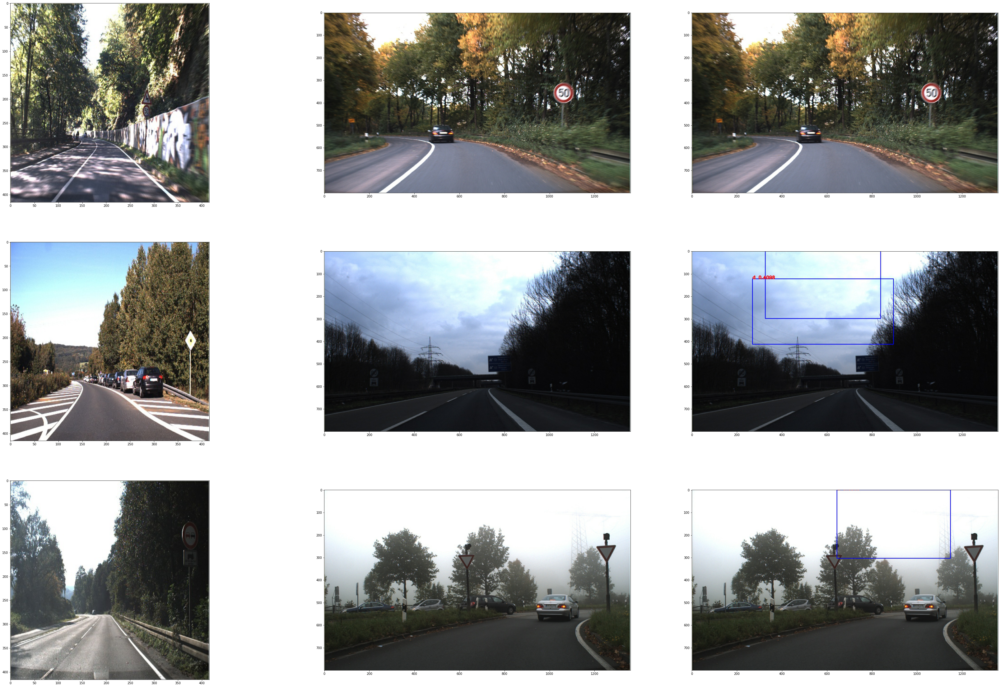

In [207]:
#plotting images
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
w=10
h=10
fig=plt.figure(figsize=(60, 40))
columns = 3
rows = 3
for i in range(1, columns*rows +1):
    img = mpimg.imread(images[i-1])
    fig.add_subplot(rows, columns, i)
    plt.imshow(img)
plt.show()

**Augmented model better than normal model**

In [208]:
images = ['/content/data_traffic/output2.jpg',
          '/content/output/000921.jpg',
          '/content/output/000922.jpg',
          '/content/data_traffic/output6.jpg',
          '/content/output/001141.jpg',
          '/content/output/001142.jpg',
          '/content/data_traffic/output15.jpg',
          '/content/output/001191.jpg',
          '/content/output/001192.jpg',
          ]

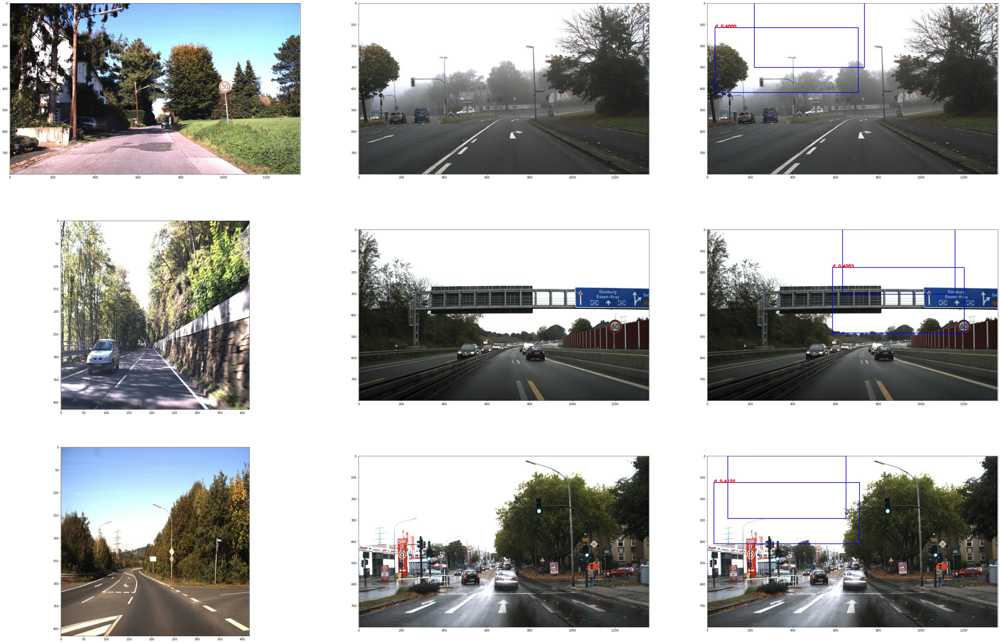

In [209]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
w=10
h=10
fig=plt.figure(figsize=(60, 40))
columns = 3
rows = 3
for i in range(1, columns*rows +1):
    img = mpimg.imread(images[i-1])
    fig.add_subplot(rows, columns, i)
    plt.imshow(img)
plt.show()

**Both models can't find the road signs**

In [210]:
images = ['/content/data_traffic/output14.jpg',
          '/content/output/002951.jpg',
          '/content/output/002952.jpg',
          '/content/data_traffic/output16.jpg',
          '/content/output/002991.jpg',
          '/content/output/002992.jpg',
          '/content/data_traffic/output7.jpg',
          '/content/output/001301.jpg',
          '/content/output/001302.jpg',
          ]

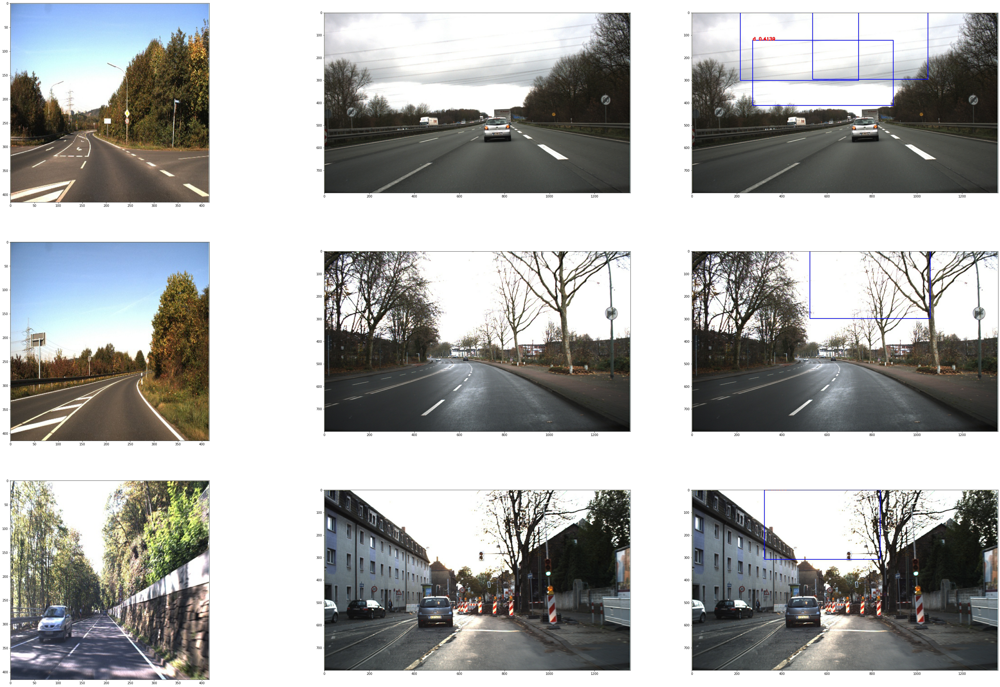

In [211]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
w=10
h=10
fig=plt.figure(figsize=(60, 40))
columns = 3
rows = 3
for i in range(1, columns*rows +1):
    img = mpimg.imread(images[i-1])
    fig.add_subplot(rows, columns, i)
    plt.imshow(img)
plt.show()